# **Analysis for Dickens Works through Module 7 (Language Models, NLP, Vector Space Models, Similarity and Clustering, PCA)**

## **DS 5001: Exploratory Text Analytics**

## **Cecily Wolfe (cew4pf)**

## **Spring 2022**

In [1]:
# read in docs

import os
from glob import glob
import numpy as np
import pandas as pd

from textparser import TextParser

import nltk
from nltk.stem.porter import PorterStemmer
from nltk.stem.snowball import SnowballStemmer
from nltk.stem.lancaster import LancasterStemmer

from langmod import NgramCounter
from langmod import NgramLanguageModel
import itertools

import seaborn as sns
import plotly.express as px

from numpy.linalg import norm
from scipy.spatial.distance import pdist
import scipy.cluster.hierarchy as sch
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

from bow_tfidf_pca import create_bow, get_tfidf, get_pca
from prince import PCA

In [2]:
sns.set()

In [3]:
OHCO = ["book_id", "chap_id", "para_num", "sent_num", "token_num"]

In [4]:
SENTS = OHCO[:4]
PARAS = OHCO[:3]
CHAPS = OHCO[:2]
BOOKS = OHCO[:1]

In [5]:
LIB = pd.read_csv("dickens_pre_LIB.csv").set_index(BOOKS).sort_index()

In [6]:
CORPUS = pd.read_csv("dickens_pre_CORPUS.csv").set_index(OHCO)

# remove NaN values
CORPUS = CORPUS[~CORPUS.term_str.isna()]

In [7]:
VOCAB = pd.read_csv("dickens_pre_VOCAB.csv")

VOCAB['term_str'] = VOCAB['term_str'].astype('str')

VOCAB = VOCAB.set_index('term_str')

In [8]:
VOCAB

,n,n_chars,p,i,max_pos,n_pos,cat_pos,stop,stem_porter,stem_snowball,stem_lancaster
term_str,,,,,,,,,,,
0,60,1,1.207251e-05,16.337915,CD,4,"{'RB', 'CD', 'NN', 'JJ'}",0,0,0,0
1,38,1,7.645923e-06,16.996878,CD,5,"{'NNP', 'CD', 'VB', 'NN', 'JJ'}",0,1,1,1
10,8,2,1.609668e-06,19.244805,CD,4,"{'NNP', 'IN', 'CD', 'NN'}",0,10,10,10
100,4,3,8.048340e-07,20.244805,CD,4,"{'JJ', 'IN', 'CD', 'NN'}",0,100,100,100
1000,1,4,2.012085e-07,22.244805,JJ,1,{'JJ'},0,1000,1000,1000
...,...,...,...,...,...,...,...,...,...,...,...
æolian,2,6,4.024170e-07,21.244805,JJ,1,{'JJ'},0,æolian,æolian,æol
æsop,1,4,2.012085e-07,22.244805,NN,1,{'NN'},0,æsop,æsop,æsop
éclat,1,5,2.012085e-07,22.244805,NN,1,{'NN'},0,éclat,éclat,éclat


In [9]:
LIB

,source_file_path,title,chap_regex,author,type,year,decade,n_chaps,book_len
book_id,,,,,,,,,
98,Dickens/98-a_tale_of_two_cities.txt,a tale of two cities,^\s*CHAPTER\s*[IVXLCM]+\.$,dickens,novel,1859,1850,45,137089
564,Dickens/564-the_mystery_of_edwin_drood.txt,the mystery of edwin drood,^CHAPTER\s[IVXLCM]+\.$,dickens,novel,1870,1870,23,96378
580,Dickens/580-the_pickwick_papers.txt,the pickwick papers,^CHAPTER\s[IVXLCM]+\.\s[A-Z]+,dickens,novel,1836,1830,57,302570
588,Dickens/588-master_humphreys_clock.txt,master humphreys clock,^(?:[IVXLCM]+$|TO THE READERS OF),dickens,stories,1840,1840,7,47084
644,Dickens/644-the_haunted_man_and_the_ghosts_bar...,the haunted man and the ghosts bargain,^CHAPTER\s[IVXLCM]+$,dickens,stories,1848,1840,3,33904
650,Dickens/650-pictures_from_italy.txt,pictures from italy,THE READER’S PASSPORT|GOING THROUGH FRANCE|LYO...,dickens,non-fiction,1846,1840,11,73007
653,Dickens/653-the_chimes.txt,the chimes,^CHAPTER\s[IVXLCM]+,dickens,novel,1844,1840,4,30742
675,Dickens/675-american_notes.txt,american notes,^CHAPTER\s[IVXLCM]+$,dickens,non-fiction,1842,1840,18,103305
676,Dickens/676-the_battle_of_life.txt,the battle of life,^Part the [A-Z][a-z]+$,dickens,novel,1846,1840,3,29679


In [10]:
CORPUS

pos_tuple  pos  \
book_id chap_id para_num sent_num token_num                             
98      1       0        0        0                ('The', 'DT')   DT   
                                  1             ('Period', 'NN')   NN   
                1        0        0                ('It', 'PRP')  PRP   
                                  1               ('was', 'VBD')  VBD   
                                  2                ('the', 'DT')   DT   
...                                                          ...  ...   
35536   13      16       0        12          ('Charles', 'NNP')  NNP   
                                  13         ('Dickens,', 'NNP')  NNP   
                                  14                ('by', 'IN')   IN   
                                  15          ('Charles', 'NNP')  NNP   
                                  16          ('Dickens', 'NNP')  NNP   

                                            token_str term_str  
book_id chap_id para_num sent_num token_num                     
98      1       0        0        0               The      the  
                                  1            Period   period  
                1        0        0                It       it  
                                  1               was      was  
                                  2               the      the  
...                                               ...      ...  
35536   13      16       0        12          Charles  charles  
                                  13         Dickens,  dickens  
                                  14               by       by  
                                  15          Charles  charles  
                                  16          Dickens  dickens  

[4969964 rows x 4 columns]

## **M03: Language Models**

### **Create Training Vocab ($V_{train}$)**

In [11]:
V_TRAIN = sorted(list(set(VOCAB.index)))

In [12]:
len(V_TRAIN)

55271

### **Generate Training Sentences**

In [13]:
# convert col type to str otherwise errors when generating training sentences
CORPUS['term_str'] = CORPUS.term_str.astype('str')
CORPUS['token_str'] = CORPUS.term_str.astype('str')

In [14]:
S_TRAIN = list(CORPUS.groupby(OHCO[:-1]).term_str.apply(lambda x: ' '.join(x)).values)

In [15]:
len(S_TRAIN)

238366

In [16]:
S_TRAIN[:5]

['the period',
 'it was the best of times it was the worst of times it was the age of wisdom it was the age of foolishness it was the epoch of belief it was the epoch of incredulity it was the season of light it was the season of darkness it was the spring of hope it was the winter of despair we had everything before us we had nothing before us we were all going direct to heaven we were all going direct the other way in short the period was so far like the present period that some of its noisiest authorities insisted on its being received for good or for evil in the superlative degree of comparison only',
 'there were a king with a large jaw and a queen with a plain face on the throne of england there were a king with a large jaw and a queen with a fair face on the throne of france',
 'in both countries it was clearer than crystal to the lords of the state preserves of loaves and fishes that things in general were settled for ever',
 'it was the year of our lord one thousand seven hund

### **Generate and Count Ngrams**

In [17]:
train = NgramCounter(S_TRAIN, V_TRAIN)
train.generate()

### **n-gram token table**

In [18]:
train.I

w0       w1       w2
sent_num token_num                           
0        0              <s>      <s>      the
         1              <s>      the   period
         2              the   period     </s>
         3           period     </s>      <s>
         4             </s>      <s>      <s>
...                     ...      ...      ...
238365   15         dickens       by  charles
         16              by  charles  dickens
         17         charles  dickens     </s>
         18         dickens     </s>      NaN
         19            </s>      NaN      NaN

[5685062 rows x 3 columns]

### **Unigram table**

In [144]:
stop_words = VOCAB.loc[VOCAB.stop == 1].index.values

In [145]:
unigram_df = train.LM[0].sort_values('n', ascending = False)
unigram_df

,n,mle,p,log_p
w0,,,,
<s>,476732,8.385696e-02,8.385696e-02,-3.575926
the,257061,4.521692e-02,4.521692e-02,-4.466993
</s>,238366,4.192848e-02,4.192848e-02,-4.575926
and,181975,3.200933e-02,3.200933e-02,-4.965364
of,136169,2.395207e-02,2.395207e-02,-5.383706
...,...,...,...,...
modernizing,1,1.758996e-07,1.758996e-07,-22.438745
modernised,1,1.758996e-07,1.758996e-07,-22.438745
brimmy,1,1.758996e-07,1.758996e-07,-22.438745


In [146]:
unigram_df.filter(regex = '^[^<]', axis = 0)

,n,mle,p,log_p
w0,,,,
the,257061,4.521692e-02,4.521692e-02,-4.466993
and,181975,3.200933e-02,3.200933e-02,-4.965364
of,136169,2.395207e-02,2.395207e-02,-5.383706
to,131034,2.304883e-02,2.304883e-02,-5.439163
a,112660,1.981685e-02,1.981685e-02,-5.657129
...,...,...,...,...
modernizing,1,1.758996e-07,1.758996e-07,-22.438745
modernised,1,1.758996e-07,1.758996e-07,-22.438745
brimmy,1,1.758996e-07,1.758996e-07,-22.438745


### **Bigram table**

In [147]:
bigram_df = train.LM[1].sort_values('n', ascending = False)
bigram_df

n           mle      mle2         p      log_p
w0     w1                                                          
<s>    <s>      238366  4.192849e-02  0.500000  0.448055  -1.158253
</s>   <s>      238365  4.192831e-02  0.999996  0.811768  -0.300860
of     the       27530  4.842516e-03  0.202175  0.143809  -2.797771
<s>    i         23498  4.133289e-03  0.049290  0.044171  -4.500766
in     the       22859  4.020889e-03  0.258294  0.159002  -2.652885
...                ...           ...       ...       ...        ...
his    doubled       1  1.758996e-07  0.000016  0.000017 -15.828756
       doublet       1  1.758996e-07  0.000016  0.000017 -15.828756
       doubt         1  1.758996e-07  0.000016  0.000017 -15.828756
       doughty       1  1.758996e-07  0.000016  0.000017 -15.828756
ěngine driver        1  1.758996e-07  1.000000  0.000036 -14.754287

[1027728 rows x 5 columns]

In [148]:
reduced_bigram = bigram_df.reset_index()

# remove spaces
reduced_bigram = reduced_bigram.loc[~((reduced_bigram.w0.str.contains('<')) | (reduced_bigram.w1.str.contains('<')))]

# remove stop words
reduced_bigram = reduced_bigram.loc[~((reduced_bigram.w0.isin(stop_words)) | (reduced_bigram.w1.isin(stop_words)))].set_index(['w0', 'w1'])

reduced_bigram

n           mle      mle2         p      log_p
w0     w1                                                         
said   mr        4790  8.425591e-04  0.160523  0.056291  -4.150964
mr     pickwick  2062  3.627050e-04  0.068685  0.024187  -5.369612
said   mrs       1379  2.425656e-04  0.046213  0.016214  -5.946622
dont   know      1304  2.293731e-04  0.198962  0.021108  -5.566092
old    man       1215  2.137180e-04  0.121841  0.018638  -5.745630
...               ...           ...       ...       ...        ...
hired  phaeton      1  1.758996e-07  0.010526  0.000036 -14.756739
       post         1  1.758996e-07  0.010526  0.000036 -14.756739
       service      1  1.758996e-07  0.010526  0.000036 -14.756739
       serving      1  1.758996e-07  0.010526  0.000036 -14.756739
ěngine driver       1  1.758996e-07  1.000000  0.000036 -14.754287

[476314 rows x 5 columns]

### **Trigram table**

In [149]:
trigram_df = train.LM[2].sort_values('n', ascending = False)
trigram_df

n           mle      mle2             p      log_p
w0     w1     w2                                                            
</s>   <s>    <s>    238365  4.192832e-02  1.000000  7.801894e-05 -13.645816
<s>    <s>    i       23498  4.133290e-03  0.098579  7.691395e-06 -16.988323
              the     15448  2.717298e-03  0.064808  5.056571e-06 -17.593409
              he       9972  1.754071e-03  0.041835  3.264236e-06 -18.224823
              it       8071  1.419686e-03  0.033860  2.642025e-06 -18.529924
...                     ...           ...       ...           ...        ...
he     closed one         1  1.758996e-07  0.025641  6.546658e-10 -30.508522
              with        1  1.758996e-07  0.025641  6.546658e-10 -30.508522
       closes early       1  1.758996e-07  0.500000  6.546658e-10 -30.508522
              his         1  1.758996e-07  0.500000  6.546658e-10 -30.508522
ěngine driver whom        1  1.758996e-07  1.000000  6.546658e-10 -30.508522

[2917374 rows x 5 columns]

In [150]:
reduced_trigram = trigram_df.reset_index()

# remove spaces
reduced_trigram = reduced_trigram.loc[~((reduced_trigram.w0.str.contains('<')) | (reduced_trigram.w1.str.contains('<')) | (reduced_trigram.w2.str.contains('<')))]

# remove stop words
reduced_trigram = reduced_trigram.loc[~((reduced_trigram.w0.isin(stop_words)) | (reduced_trigram.w1.isin(stop_words)) | (reduced_trigram.w2.isin(stop_words)))].set_index(['w0', 'w1', 'w2'])

reduced_trigram

n           mle      mle2             p  \
w0       w1       w2                                                     
said     mr       pickwick   598  1.051880e-04  0.124843  1.960721e-07   
sir      said     mr         322  5.663968e-05  0.268110  1.057285e-07   
said     mr       pecksniff  247  4.344721e-05  0.051566  8.117843e-08   
                  boffin     203  3.570763e-05  0.042380  6.677580e-08   
                  dombey     201  3.535583e-05  0.041962  6.612114e-08   
...                          ...           ...       ...           ...   
havisham dwelt    upon         1  1.758996e-07  1.000000  6.546658e-10   
         ever     made         1  1.758996e-07  1.000000  6.546658e-10   
         going    along        1  1.758996e-07  1.000000  6.546658e-10   
         horribly cruel        1  1.758996e-07  1.000000  6.546658e-10   
         however  sir          1  1.758996e-07  1.000000  6.546658e-10   

                                 log_p  
w0       w1       w2                    
said     mr       pickwick  -22.282112  
sir      said     mr        -23.173133  
said     mr       pecksniff -23.554328  
                  boffin    -23.836099  
                  dombey    -23.850313  
...                                ...  
havisham dwelt    upon      -30.508522  
         ever     made      -30.508522  
         going    along     -30.508522  
         horribly cruel     -30.508522  
         however  sir       -30.508522  

[271763 rows x 5 columns]

In [152]:
LIB.type.value_counts()

stories        26
novel          17
non-fiction     7
Name: type, dtype: int64

### **Create language model**

In [22]:
# generate n-gram model using n-gram counter
model = NgramLanguageModel(train)

# implement smoothing (with k = 1) to prevent zero prob. for n-grams unseen in training data
model.k = 1
model.apply_smoothing()

In [23]:
# list of ngram token tables for unigram, bigram, trigram
ngram = model.NG

# list of unigram, bigram, trigram dfs with count, max likelihood estimate (MLE), joint prob, log joint prob, conditional prob, log conditional prob
LM = model.LM

Z1 = model.Z1

Z2 = model.Z2

### **Generate a text with the `.generate_text()` method of the `langmod.NgramLanguageModel` object (`model`)**

In [24]:
model.generate_text()

01. I NEVER THOUGHT ABOUT GOING TO BE DYING IN THAT NEIGHBOURHOOD BY ACCIDENT.

02. YES SIR.

03. OF OUR TWO INDIVIDUAL NATURES AND THEY LIVE IN A MOMENT.

04. GIVE HIM TO GO OUT WITH THE OBJECT OF THE CONTENTS OF HIS.

05. BURIED HOW LONG THAT HE WAS CARRIED OFF UPON HER AT THE ALBION IN LITTLE RUSSELL STREET.

06. FOR A MOMENT.

07. MUCH NEEDED COULD A FEW LEAVES AND THERE HE SAID AGAIN.

08. YES CHILD SAID THE MILITARY GENTLEMAN ADDRESSING THE OLD GENTLEMAN NOT EIGHT BLUE SKIES IN AS INDIFFERENT AND SO HAVE I MAY SAID MR CHESTER.

09. IT HAD RECEIVED IN TURF AND THE SEDATE FACE IN THE COMPANY OF A BUCKET AND MRS QUILP HE SAID THAT WHEREVER GAY IS PROBABLY ACQUAINTEDCANNOT SAY A COINCIDENCE A REMARKABLE KIND OF NEAT LITTLE ROOM PUT A BRIGHTER COUNTENANCE AND AS THERE CAN BE TAKEN OFF THE GROUND THE STOPPING OF THE UNFORTUNATE CHILDREN WHOSE WERRY SUBSISTENCE DEPENDS ON THEIR WAY.

10. O NO.

11. I HAD TO TELL ME ALL THEM ANCESTORS OF YOURS I BEG YOUR PARDON AND TELL US.

12. MY DEAR 

### **Examining redundancy for unigrams, bigrams, trigrams $\rightarrow$ redundancy increases**

* Entropy equation for n-grams (ng): $H = {\sum}p(ng)log_2(\frac{1}{p(ng)})$, where $p$ is the `.mle` in the unigram, bigram, and trigram tables in the language model
* Redundancy: $R = 1 - \frac{H}{H_{max}}$, where $H$ is the actual model entropy and $H_{max} = \frac{1}{n} * log_2(\frac{1}{n}) * n = log_2(\frac{1}{n})$ is the max entropy

In [25]:
V = len(VOCAB)

In [26]:
R = []
for i in range(3):
    N = V**(i+1)
    H = (train.LM[i]['mle'] * np.log2(1/train.LM[i]['mle'])).sum()
    Hmax = np.log2(N)
    R.append(int(round(1 - H/Hmax, 2) * 100))

In [27]:
R

[41, 50, 59]

### **Using the bigram model represented as a matrix (too large to use `BGX = model.LM[1].n.unstack()` so use method below), explore the relationship between bigram pairs using the following lists for the first and second words of the bigrams of interest**

In [28]:
w0 = ['he', 'she']

w1 = ['said', 'heard']

bigram_pairs = [i for i in itertools.combinations(w0 + w1, 2) if i[0] in w0 and i[1] in w1]

In [29]:
LM[1].loc[bigram_pairs].n.unstack()

w1,said,heard
w0,,
he,1855,197
she,692,59


## **M05: Vector Space Models**

### **Zipf's Law**:

* **Equation**: $f \propto \frac{1}{r} \rightarrow f = \frac{k}{r}$, where $k = fr$
    * f: token frequency
    * r: token rank $\rightarrow$ okens ordered in terms of frequency s.t. rank $r = 1, 2, 3, ..., N$, where $N$ is the number of tokens and the token with rank $r = 1$ is the most frequent token

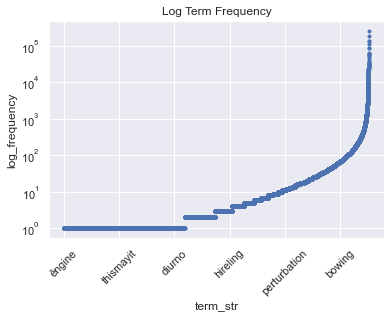

In [30]:
VOCAB.n.sort_values().plot(ylabel = "log_frequency", logy=True, style = '.', rot = 45, title = "Log Term Frequency");


### **Add Term Rank $r$ to `VOCAB`**

In [31]:
if 'term_rank' not in VOCAB.columns:
    VOCAB = VOCAB.sort_values('n', ascending = False).reset_index()
    VOCAB.index.name = 'term_rank'
    VOCAB = VOCAB.reset_index()
    VOCAB['term_rank'] = VOCAB['term_rank'] + 1
    VOCAB = VOCAB.set_index('term_str')

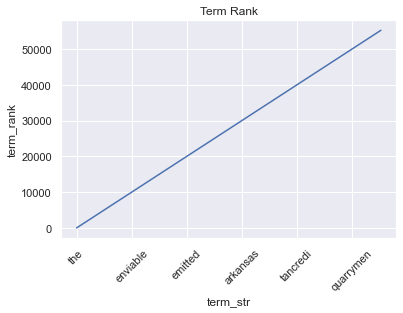

In [32]:
VOCAB.term_rank.plot(ylabel = "term_rank", logx = False, rot = 45, title = "Term Rank");

In [33]:
VOCAB.head()

,term_rank,n,n_chars,p,i,max_pos,n_pos,cat_pos,stop,stem_porter,stem_snowball,stem_lancaster
term_str,,,,,,,,,,,,
the,1,257061,3,0.051723,4.273054,DT,20,"{'NNP', 'CD', 'NNS', 'FW', 'POS', 'PRP', 'CC',...",1,the,the,the
and,2,181975,3,0.036615,4.771425,CC,18,"{'NNP', 'CC', 'VBD', 'CD', 'DT', 'PDT', 'VBN',...",1,and,and,and
of,3,136169,2,0.027398,5.189767,IN,18,"{'NNP', 'PRP', 'VBD', 'CD', 'PDT', 'VBN', 'VBP...",1,of,of,of
to,4,131034,2,0.026365,5.245224,TO,21,"{'NNP', 'CD', 'EX', 'NNS', 'FW', 'POS', 'CC', ...",1,to,to,to
a,5,112660,1,0.022668,5.463190,DT,19,"{'NNP', 'CD', 'NNS', 'FW', 'POS', 'PRP', 'VBN'...",1,a,a,a


### **Alternate Rank: words that appear the same number of times given the same rank**

In [34]:
# times each num of times a term appears (e.g., 18273 terms appear 1 time)
# sort in descending order
# reset indices and rename cols --> nn: times each num of times a term appears

new_rank = VOCAB.n.value_counts()\
                   .sort_index(ascending = False).reset_index().reset_index()\
                   .rename(columns={'level_0': 'term_rank2', 'index': 'n', 'n': 'nn'})\
                    .set_index('n')

VOCAB['term_rank2'] = VOCAB.n.map(new_rank.term_rank2) + 1

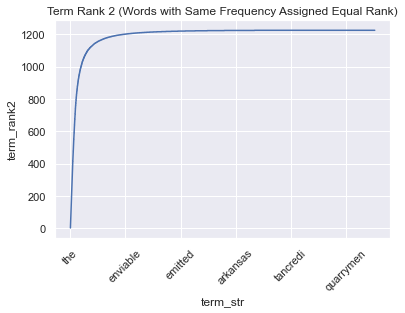

In [35]:
VOCAB.term_rank2.plot(ylabel = 'term_rank2', logx = False, rot = 45, title = "Term Rank 2 (Words with Same Frequency Assigned Equal Rank)");

### **Compute Zipf's $k$ using `term_rank` and `term_rank2`**

* **Equation**: $k = fr$

In [36]:
VOCAB['zipf_k'] = VOCAB.n * VOCAB.term_rank
VOCAB['zipf_k2'] = VOCAB.n * VOCAB.term_rank2

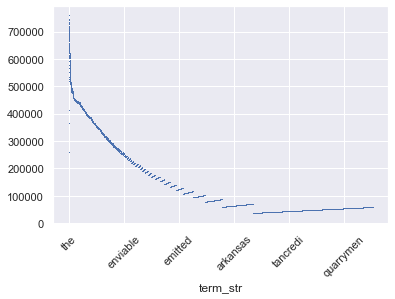

In [37]:
VOCAB.zipf_k.plot(style = ',', rot = 45);

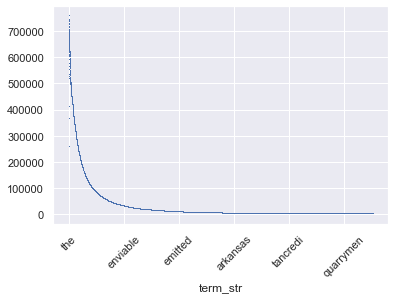

In [38]:
VOCAB.zipf_k2.plot(style = ',', rot = 45);

### **Rank vs. N (frequency `n`)**

As rank (`term_rank2`) increases, frequnecy (`n`) decreases

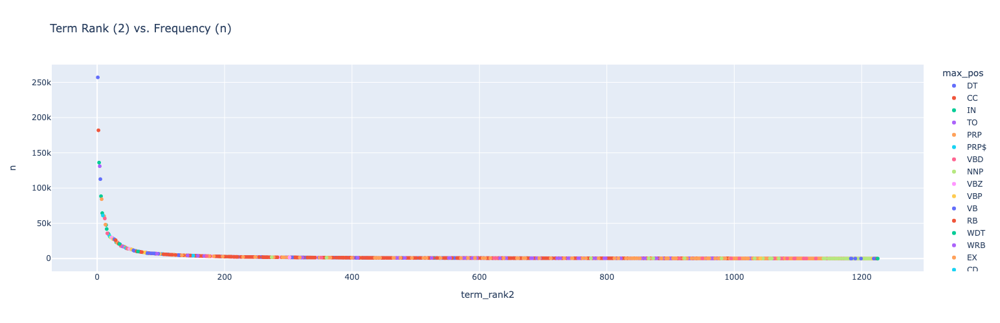

In [39]:
# scatter plot of term_rank2 vs. n color coded by part of speech (POS)

px.scatter(VOCAB.reset_index(),
           x = 'term_rank2', y = 'n',
           title = 'Term Rank (2) vs. Frequency (n)',
           log_y = False, log_x = False,
           hover_name = 'term_str',
           color = 'max_pos',
           height = 500, width = 800)

### **BOW (Bag of Words) and TFIDF (Term Frequency - Inverse Document Frequency)**

In [40]:
BOW = create_bow(CORPUS, CHAPS)

In [41]:
DTCM, TFIDF, BOW, DFIDF, VOCAB = get_tfidf(BOW, VOCAB, tf_method = 'max', idf_method = 'standard')

In [42]:
VOCAB

,term_rank,n,n_chars,p,i,max_pos,n_pos,cat_pos,stop,stem_porter,stem_snowball,stem_lancaster,term_rank2,zipf_k,zipf_k2,tfidf_mean_chap_max,tfidf_max_chap_max,df,idf,dfidf
term_str,,,,,,,,,,,,,,,,,,,,
the,1,257061,3,5.172286e-02,4.273054,DT,20,"{'NNP', 'CD', 'NNS', 'FW', 'POS', 'PRP', 'CC',...",1,the,the,the,1,257061,257061,0.000000,0.000000,1182.0,0.000000,0.000000
and,2,181975,3,3.661492e-02,4.771425,CC,18,"{'NNP', 'CC', 'VBD', 'CD', 'DT', 'PDT', 'VBN',...",1,and,and,and,2,363950,363950,0.000000,0.000000,1182.0,0.000000,0.000000
of,3,136169,2,2.739836e-02,5.189767,IN,18,"{'NNP', 'PRP', 'VBD', 'CD', 'PDT', 'VBN', 'VBP...",1,of,of,of,3,408507,408507,0.000000,0.000000,1182.0,0.000000,0.000000
to,4,131034,2,2.636515e-02,5.245224,TO,21,"{'NNP', 'CD', 'EX', 'NNS', 'FW', 'POS', 'CC', ...",1,to,to,to,4,524136,524136,0.000000,0.000000,1182.0,0.000000,0.000000
a,5,112660,1,2.266815e-02,5.463190,DT,19,"{'NNP', 'CD', 'NNS', 'FW', 'POS', 'PRP', 'VBN'...",1,a,a,a,5,563300,563300,0.000000,0.000000,1182.0,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
lushed,55268,1,6,2.012085e-07,22.244805,VBP,1,{'VBP'},0,lush,lush,lush,1225,55268,1225,0.031601,0.031601,1.0,10.207014,10.207014
lurker,55269,1,6,2.012085e-07,22.244805,NN,1,{'NN'},0,lurker,lurker,lurk,1225,55269,1225,0.046396,0.046396,1.0,10.207014,10.207014
lunns,55270,1,5,2.012085e-07,22.244805,NNP,1,{'NNP'},0,lunn,lunn,lun,1225,55270,1225,0.029586,0.029586,1.0,10.207014,10.207014


### **Document-Term Count Matrix `DTCM`**

In [43]:
DTCM

term_str           0    1   10  100  1000  10000  10000l  1000l  100l  1030  \
book_id chap_id                                                               
98      1        0.0  0.0  0.0  0.0   0.0    0.0     0.0    0.0   0.0   0.0   
        2        0.0  0.0  0.0  0.0   0.0    0.0     0.0    0.0   0.0   0.0   
        3        0.0  0.0  0.0  0.0   0.0    0.0     0.0    0.0   0.0   0.0   
        4        0.0  0.0  0.0  0.0   0.0    0.0     0.0    0.0   0.0   0.0   
        5        0.0  0.0  0.0  0.0   0.0    0.0     0.0    0.0   0.0   0.0   
...              ...  ...  ...  ...   ...    ...     ...    ...   ...   ...   
35536   9        0.0  0.0  0.0  0.0   0.0    0.0     0.0    0.0   0.0   0.0   
        10       0.0  0.0  0.0  0.0   0.0    0.0     0.0    0.0   0.0   0.0   
        11       0.0  0.0  0.0  0.0   0.0    0.0     0.0    0.0   0.0   0.0   
        12       0.0  0.0  0.0  0.0   0.0    0.0     0.0    0.0   0.0   0.0   
        13       0.0  1.0  0.0  0.0   0.0    0.0     0.0    0.0   0.0   0.0   

term_str         ...  zooks  zoological  zounds  zulu    à  æolian  æsop  \
book_id chap_id  ...                                                       
98      1        ...    0.0         0.0     0.0   0.0  0.0     0.0   0.0   
        2        ...    0.0         0.0     0.0   0.0  0.0     0.0   0.0   
        3        ...    0.0         0.0     0.0   0.0  0.0     0.0   0.0   
        4        ...    0.0         0.0     0.0   0.0  0.0     0.0   0.0   
        5        ...    0.0         0.0     0.0   0.0  0.0     0.0   0.0   
...              ...    ...         ...     ...   ...  ...     ...   ...   
35536   9        ...    0.0         0.0     0.0   0.0  0.0     0.0   0.0   
        10       ...    0.0         0.0     0.0   0.0  0.0     0.0   0.0   
        11       ...    0.0         0.0     0.0   0.0  0.0     0.0   0.0   
        12       ...    0.0         0.0     0.0   0.0  0.0     0.0   0.0   
        13       ...    0.0         0.0     0.0   0.0  0.0     0.0   0.0   

term_str         éclat  élite  ěngine  
book_id chap_id                        
98      1          0.0    0.0     0.0  
        2          0.0    0.0     0.0  
        3          0.0    0.0     0.0  
        4          0.0    0.0     0.0  
        5          0.0    0.0     0.0  
...                ...    ...     ...  
35536   9          0.0    0.0     0.0  
        10         0.0    0.0     0.0  
        11         0.0    0.0     0.0  
        12         0.0    0.0     0.0  
        13         0.0    0.0     0.0  

[1182 rows x 55270 columns]

### **Reduce number of features in `VOCAB`, TFIDF matrix to the 1000 most significant terms**
* #### DFIDF: the significance measure
* #### Only include terms whose maximum part-of-speech belongs to this set:
    * #### NN NNS VB VBD VBG VBN VBP VBZ JJ JJR JJS RB RBR RBS.
    * #### Note, these are all open categories, excluding proper nouns.

In [44]:
# open POS categories
open_cats = ['NN', 'NNS', 'VB', 'VBD', 'VBG', 'VBN', 'VBP', 'VBZ', 'JJ',
             'JJR', 'JJS', 'RB', 'RBR', 'RBS']

# reduce VOCAB to significant terms --> filter POS, sort , take top 1000
SIGS = VOCAB.loc[VOCAB.max_pos.isin(open_cats)] \
            .sort_values('dfidf', ascending = False) \
            .iloc[:1000,]

In [154]:
SIGS.head(10).index.values

array(['seem', 'entered', 'sleep', 'cut', 'top', 'windows', 'dress',
       'thank', 'worse', 'sent'], dtype=object)

### **"Collapse" the TFIDF matrix so that it contains mean TFIDF of each term by book.**

* #### **Result: matrix with book IDs as rows, significant terms as cols**

In [46]:
TFIDF

term_str           0         1   10  100  1000  10000  10000l  1000l  100l  \
book_id chap_id                                                              
98      1        0.0  0.000000  0.0  0.0   0.0    0.0     0.0    0.0   0.0   
        2        0.0  0.000000  0.0  0.0   0.0    0.0     0.0    0.0   0.0   
        3        0.0  0.000000  0.0  0.0   0.0    0.0     0.0    0.0   0.0   
        4        0.0  0.000000  0.0  0.0   0.0    0.0     0.0    0.0   0.0   
        5        0.0  0.000000  0.0  0.0   0.0    0.0     0.0    0.0   0.0   
...              ...       ...  ...  ...   ...    ...     ...    ...   ...   
35536   9        0.0  0.000000  0.0  0.0   0.0    0.0     0.0    0.0   0.0   
        10       0.0  0.000000  0.0  0.0   0.0    0.0     0.0    0.0   0.0   
        11       0.0  0.000000  0.0  0.0   0.0    0.0     0.0    0.0   0.0   
        12       0.0  0.000000  0.0  0.0   0.0    0.0     0.0    0.0   0.0   
        13       0.0  0.255548  0.0  0.0   0.0    0.0     0.0    0.0   0.0   

term_str         1030  ...  zooks  zoological  zounds  zulu    à  æolian  \
book_id chap_id        ...                                                 
98      1         0.0  ...    0.0         0.0     0.0   0.0  0.0     0.0   
        2         0.0  ...    0.0         0.0     0.0   0.0  0.0     0.0   
        3         0.0  ...    0.0         0.0     0.0   0.0  0.0     0.0   
        4         0.0  ...    0.0         0.0     0.0   0.0  0.0     0.0   
        5         0.0  ...    0.0         0.0     0.0   0.0  0.0     0.0   
...               ...  ...    ...         ...     ...   ...  ...     ...   
35536   9         0.0  ...    0.0         0.0     0.0   0.0  0.0     0.0   
        10        0.0  ...    0.0         0.0     0.0   0.0  0.0     0.0   
        11        0.0  ...    0.0         0.0     0.0   0.0  0.0     0.0   
        12        0.0  ...    0.0         0.0     0.0   0.0  0.0     0.0   
        13        0.0  ...    0.0         0.0     0.0   0.0  0.0     0.0   

term_str         æsop  éclat  élite  ěngine  
book_id chap_id                              
98      1         0.0    0.0    0.0     0.0  
        2         0.0    0.0    0.0     0.0  
        3         0.0    0.0    0.0     0.0  
        4         0.0    0.0    0.0     0.0  
        5         0.0    0.0    0.0     0.0  
...               ...    ...    ...     ...  
35536   9         0.0    0.0    0.0     0.0  
        10        0.0    0.0    0.0     0.0  
        11        0.0    0.0    0.0     0.0  
        12        0.0    0.0    0.0     0.0  
        13        0.0    0.0    0.0     0.0  

[1182 rows x 55270 columns]

In [47]:
TFIDF_sigs = TFIDF[SIGS.index]

In [48]:
TFIDF_sigs

term_str         seem   entered     sleep       cut       top   windows  \
book_id chap_id                                                           
98      1         0.0  0.000000  0.000000  0.018297  0.000000  0.000000   
        2         0.0  0.000000  0.000000  0.007300  0.014634  0.000000   
        3         0.0  0.000000  0.000000  0.000000  0.011779  0.011779   
        4         0.0  0.000000  0.007121  0.000000  0.000000  0.000000   
        5         0.0  0.005042  0.000000  0.005054  0.010131  0.010131   
...               ...       ...       ...       ...       ...       ...   
35536   9         0.0  0.000000  0.024499  0.000000  0.000000  0.000000   
        10        0.0  0.000000  0.000000  0.000000  0.000000  0.000000   
        11        0.0  0.000000  0.000000  0.000000  0.000000  0.000000   
        12        0.0  0.000000  0.027797  0.000000  0.000000  0.000000   
        13        0.0  0.000000  0.065703  0.000000  0.000000  0.000000   

term_str            dress     thank     worse      sent  ...  peculiar  \
book_id chap_id                                          ...             
98      1        0.000000  0.000000  0.018129  0.000000  ...       0.0   
        2        0.000000  0.000000  0.000000  0.007351  ...       0.0   
        3        0.000000  0.000000  0.000000  0.011833  ...       0.0   
        4        0.000000  0.014143  0.021166  0.007170  ...       0.0   
        5        0.005019  0.000000  0.005008  0.000000  ...       0.0   
...                   ...       ...       ...       ...  ...       ...   
35536   9        0.000000  0.000000  0.000000  0.000000  ...       0.0   
        10       0.000000  0.000000  0.000000  0.000000  ...       0.0   
        11       0.000000  0.000000  0.000000  0.000000  ...       0.0   
        12       0.000000  0.000000  0.000000  0.000000  ...       0.0   
        13       0.000000  0.000000  0.000000  0.000000  ...       0.0   

term_str             pace       art  kindness  kissed  demanded    strong  \
book_id chap_id                                                             
98      1        0.000000  0.000000       0.0     0.0  0.000000  0.000000   
        2        0.012152  0.000000       0.0     0.0  0.000000  0.000000   
        3        0.000000  0.000000       0.0     0.0  0.000000  0.018890   
        4        0.000000  0.011885       0.0     0.0  0.000000  0.015261   
        5        0.000000  0.000000       0.0     0.0  0.008436  0.008124   
...                   ...       ...       ...     ...       ...       ...   
35536   9        0.000000  0.000000       0.0     0.0  0.000000  0.000000   
        10       0.000000  0.000000       0.0     0.0  0.000000  0.000000   
        11       0.000000  0.000000       0.0     0.0  0.000000  0.011224   
        12       0.000000  0.000000       0.0     0.0  0.000000  0.014894   
        13       0.000000  0.000000       0.0     0.0  0.000000  0.000000   

term_str             felt      tall  profound  
book_id chap_id                                
98      1        0.000000  0.000000  0.000000  
        2        0.000000  0.000000  0.000000  
        3        0.000000  0.000000  0.019668  
        4        0.007630  0.023834  0.000000  
        5        0.005416  0.025375  0.008458  
...                   ...       ...       ...  
35536   9        0.000000  0.000000  0.000000  
        10       0.000000  0.000000  0.000000  
        11       0.011224  0.000000  0.000000  
        12       0.000000  0.000000  0.046521  
        13       0.000000  0.000000  0.109960  

[1182 rows x 1000 columns]

In [49]:
print('max term TFIDF value:', max(TFIDF_sigs.sum(axis=0)))

print('max TFIDF term:', TFIDF_sigs.sum(axis = 0).idxmax())

max term TFIDF value: 16.677083003000984
max TFIDF term: says


In [50]:
print('Max total TFIDF value by book and chapter:', max(TFIDF_sigs.sum(axis=1)))

print('(Book_id, chap_id) with max total TFIDF: ', TFIDF_sigs.sum(axis = 1).idxmax())

print('Title of book with max total TFIDF:', LIB.loc[TFIDF_sigs.sum(axis = 1).idxmax()[0]].title.title())

Max total TFIDF value by book and chapter: 6.716943644781024
(Book_id, chap_id) with max total TFIDF:  (786, 2)
Title of book with max total TFIDF: Hard Times


### **Rank and TFIDF Mean**

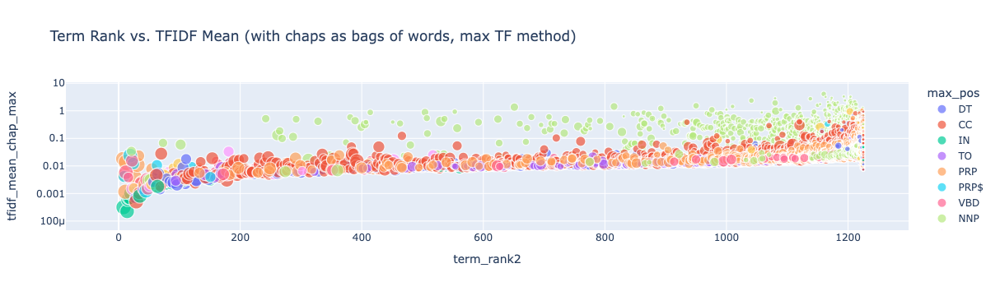

In [51]:
px.scatter(VOCAB.reset_index(),
           x = 'term_rank2', y = 'tfidf_mean_chap_max',
           title = 'Term Rank vs. TFIDF Mean (with chaps as bags of words, max TF method)',
           color = 'max_pos', size = 'n_pos',
           hover_name = 'term_str', hover_data = ['n', 'i'],
           log_y = True, log_x = False)

### **Rank and DFIDF**

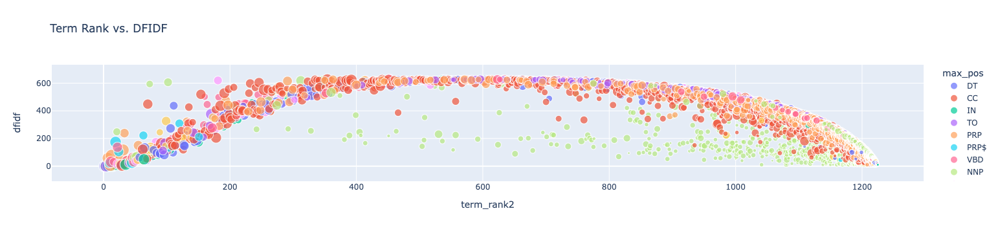

In [52]:
px.scatter(VOCAB.reset_index(),
           x = 'term_rank2', y = 'dfidf',
           title = 'Term Rank vs. DFIDF',
           color = 'max_pos', size = 'n_pos',
           hover_name = 'term_str', hover_data = ['n', 'i'])

## **M06: Similarity and Clustering**

### **Collapse Bags (to use for clustering)**

* #### Note: not the same as computing TFIDF with larger bags

#### **Mean TFIDF for each book for all terms**

In [53]:
# group by book_id (BOOKS = OHCO[:1])
mean_TFIDF = TFIDF.groupby(BOOKS).mean()

mean_TFIDF

term_str,0,1,10,100,1000,10000,10000l,1000l,100l,1030,...,zooks,zoological,zounds,zulu,à,æolian,æsop,éclat,élite,ěngine
book_id,,,,,,,,,,,,,,,,,,,,,
98,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
564,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
580,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
588,0.043555,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
644,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
650,0.000000,0.000558,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
653,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
675,0.000000,0.003390,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000621
676,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


#### **Mean TFIDF for all book for 1000 most significant terms only**

In [54]:
mean_TFIDF_sigs = TFIDF_sigs.groupby(BOOKS).mean()

mean_TFIDF_sigs

term_str,seem,entered,sleep,cut,top,windows,dress,thank,worse,sent,...,peculiar,pace,art,kindness,kissed,demanded,strong,felt,tall,profound
book_id,,,,,,,,,,,,,,,,,,,,,
98,0.002393,0.003802,0.003404,0.002195,0.003124,0.004978,0.004351,0.005878,0.003747,0.002506,...,0.001738,0.001090,0.001950,0.000459,0.006159,0.002523,0.006633,0.002546,0.003738,0.001328
564,0.010476,0.002771,0.004620,0.003763,0.004910,0.009007,0.004279,0.009971,0.004176,0.002999,...,0.001572,0.003426,0.001709,0.005448,0.006385,0.004860,0.005815,0.002857,0.001353,0.000854
580,0.001633,0.006892,0.004072,0.003512,0.004892,0.002329,0.002140,0.003107,0.002812,0.003906,...,0.002933,0.003073,0.001058,0.002970,0.002512,0.002451,0.002353,0.003885,0.005744,0.005382
588,0.005328,0.002433,0.003914,0.004394,0.005007,0.001695,0.001646,0.000554,0.002704,0.001996,...,0.008652,0.004240,0.002823,0.003903,0.002602,0.003754,0.004059,0.007125,0.001124,0.002809
644,0.001645,0.002681,0.008029,0.002687,0.003306,0.003628,0.002669,0.003647,0.004668,0.001714,...,0.001105,0.001105,0.000000,0.002215,0.012132,0.003323,0.001968,0.007221,0.000000,0.002849
650,0.002964,0.004217,0.002264,0.002753,0.005130,0.010857,0.004136,0.000236,0.004408,0.003582,...,0.000643,0.002314,0.002853,0.000000,0.001313,0.000000,0.003488,0.002304,0.002603,0.000157
653,0.006889,0.002919,0.006016,0.006939,0.002016,0.003991,0.004952,0.006012,0.000000,0.001975,...,0.003401,0.004923,0.000000,0.001748,0.005076,0.000000,0.004352,0.006439,0.000000,0.000000
675,0.005027,0.001698,0.003040,0.003983,0.005156,0.007240,0.003041,0.000871,0.002810,0.002865,...,0.002345,0.004288,0.001284,0.001235,0.001501,0.000464,0.004678,0.002227,0.005158,0.000687
676,0.008455,0.001075,0.000930,0.006221,0.004716,0.002210,0.004477,0.004379,0.003253,0.005625,...,0.001794,0.005137,0.001553,0.004255,0.009159,0.000000,0.000498,0.004095,0.000000,0.000000


### **`DOC` Table**

* #### Same as `LIB` table when books are docs

In [55]:
book_DOC = pd.DataFrame(index = mean_TFIDF.index)

In [56]:
book_DOC = book_DOC.join(LIB[['author', 'title']])

book_DOC['label'] = book_DOC.apply(lambda x: f"{x.author.split(',')[0]} {x.name}: {x.title}", 1)

In [57]:
book_DOC

,author,title,label
book_id,,,
98,dickens,a tale of two cities,dickens 98: a tale of two cities
564,dickens,the mystery of edwin drood,dickens 564: the mystery of edwin drood
580,dickens,the pickwick papers,dickens 580: the pickwick papers
588,dickens,master humphreys clock,dickens 588: master humphreys clock
644,dickens,the haunted man and the ghosts bargain,dickens 644: the haunted man and the ghosts ba...
650,dickens,pictures from italy,dickens 650: pictures from italy
653,dickens,the chimes,dickens 653: the chimes
675,dickens,american notes,dickens 675: american notes
676,dickens,the battle of life,dickens 676: the battle of life


### **Normalized Tables for Clustering**

In [58]:
# binary table
L0 = mean_TFIDF_sigs.astype('bool').astype('int')

# Manhattan distance (L1 norm): divide each value by sum down cols
L1 = mean_TFIDF_sigs.apply(lambda x: x / x.sum(), 1)

# Euclidean distance (L2 norm)
L2 = mean_TFIDF_sigs.apply(lambda x: x / norm(x), 1) # Euclidean

In [59]:
assert round(L1.sum(1).sum()) == len(mean_TFIDF_sigs)

In [60]:
assert round(((L2.T)**2).sum().sum()) == len(mean_TFIDF_sigs)

### **Create table of book pairs (doc pair table `PAIRS`)**

In [61]:
mean_TFIDF_sigs.T.corr().stack()

book_id  book_id
98       98         1.000000
         564        0.182350
         580       -0.002878
         588        0.053118
         644        0.321641
                      ...   
35536    2324       0.075841
         19337      0.057664
         20795      0.008652
         27924      0.033643
         35536      1.000000
Length: 2500, dtype: float64

In [62]:
# correlation between books --> stack and convert to df with col for  raw correlation vals
PAIRS = 1 - mean_TFIDF_sigs.T.corr().stack().to_frame('corr_raw')

# rename indices
PAIRS.index.names = ['doc_a', 'doc_b']

# remove identities (e.g., corr(105, 105) and reverse dupliciates (e.g., corr(105, 121) = corr(121, 105))
PAIRS = PAIRS.query("doc_a > doc_b")

In [63]:
PAIRS

corr_raw
doc_a doc_b          
564   98     0.817650
580   98     1.002878
      564    0.877140
588   98     0.946882
      564    0.787186
...               ...
35536 1467   0.833318
      2324   0.924159
      19337  0.942336
      20795  0.991348
      27924  0.966357

[1225 rows x 1 columns]

#### **Compute distance measures between all pairs of books using `pdist()`**

In [64]:
combos  = [
    (mean_TFIDF_sigs, 'cityblock', 'cityblock–raw'),
    (mean_TFIDF_sigs, 'euclidean', 'euclidean–raw'),
    (L2, 'euclidean', 'euclidean–l2'),    
    (mean_TFIDF_sigs, 'cosine', 'cosine–raw'),
    (L1, 'cityblock', 'cityblock–l1'),
    (L0, 'jaccard', 'jaccard–l0'),
    (L0, 'jensenshannon', 'js–l0'),
    (L1, 'jensenshannon', 'js–l1'),
    (L2, 'jensenshannon', 'js–l2'),
]

In [65]:
for X, metric, label in combos:
    PAIRS[label] = pdist(X, metric)

#### **Compare Distributions**

In [66]:
PAIRS.head(20)

corr_raw  cityblock–raw  euclidean–raw  euclidean–l2  cosine–raw  \
doc_a doc_b                                                                     
564   98     0.817650       2.181992       0.102131      0.705128    0.248603   
580   98     1.002878       2.289080       0.110589      0.812632    0.330185   
      564    0.877140       3.089993       0.164050      0.906774    0.411119   
588   98     0.946882       2.587732       0.125556      0.770693    0.296984   
      564    0.787186       2.589356       0.115496      0.878369    0.385766   
      580    0.721002       2.894603       0.139821      0.776074    0.301146   
644   98     0.678359       2.233104       0.105889      0.811974    0.329651   
      564    0.891082       3.092410       0.154481      0.832096    0.346192   
      580    0.985001       2.331377       0.104579      0.846610    0.358374   
      588    0.984815       2.082619       0.103715      0.739933    0.273750   
650   98     0.871224       2.152545       0.108974      0.795297    0.316249   
      564    0.975258       2.305293       0.103135      0.679688    0.230988   
      580    1.049085       2.750142       0.142709      0.770513    0.296845   
      588    0.995085       4.381819       0.222845      0.999091    0.499091   
      644    1.040313       3.624371       0.256947      1.177945    0.693777   
653   98     0.723809       3.706198       0.211257      1.039313    0.540086   
      564    0.910575       1.936816       0.089189      0.634497    0.201293   
      580    0.828846       3.064535       0.151449      1.008603    0.508640   
      588    0.875357       2.195757       0.106937      0.807463    0.325998   
      644    0.658470       2.283973       0.101496      0.808304    0.326678   

             cityblock–l1  jaccard–l0     js–l0     js–l1     js–l2  
doc_a doc_b                                                          
564   98         0.560497    0.017000  0.077078  0.261065  0.261065  
580   98         0.651664    0.006000  0.045650  0.296771  0.296771  
      564        0.766355    0.047047  0.128958  0.344255  0.344255  
588   98         0.689925    0.123246  0.211748  0.330926  0.330926  
      564        0.828921    0.054162  0.138488  0.367902  0.367902  
      580        0.694771    0.134134  0.221436  0.332535  0.332535  
644   98         0.668478    0.010010  0.059048  0.303062  0.303062  
      564        0.731800    0.117117  0.206221  0.344001  0.344001  
      580        0.767106    0.036145  0.112723  0.344390  0.344390  
      588        0.561057    0.006000  0.045650  0.261069  0.261069  
650   98         0.607677    0.007000  0.049329  0.282599  0.282599  
      564        0.542875    0.006000  0.045650  0.249071  0.249071  
      580        0.626226    0.021021  0.085772  0.298195  0.298195  
      588        1.055990    0.451256  0.435729  0.494183  0.494183  
      644        1.093038    0.394975  0.401914  0.508821  0.508821  
653   98         1.052495    0.409045  0.410432  0.487383  0.487383  
      564        0.502645    0.006000  0.045650  0.233870  0.233870  
      580        0.922165    0.060241  0.146181  0.406321  0.406321  
      588        0.654300    0.014014  0.069931  0.295467  0.295467  
      644        0.703473    0.008000  0.052754  0.311239  0.311239

### **Hierarchical agglomerative cluster diagrams for the distance measures**

In [67]:
LIB['label'] = book_DOC['label']

In [155]:
def hca(sims, title="My Dendrogram", linkage_method='weighted', color_thresh=None, figsize=(15, 20)):
    
    # calculate linkage using given method   
    tree = sch.linkage(sims, method=linkage_method)
    
    # extract labels (title, year)
    labels = LIB.label.values
    
    # set color threshold
    if not color_thresh:
        color_thresh = pd.DataFrame(tree)[2].median()
    
    # plot dendrograms for each distance metric and linkage method
    plt.figure()
    fig, axes = plt.subplots(figsize=figsize)
    dendrogram = sch.dendrogram(tree, 
                                labels=labels, 
                                orientation="left", 
                                count_sort=True,
                                distance_sort=True,
                                above_threshold_color='.75',
                                color_threshold=color_thresh
                               )
    plt.tick_params(axis='both', which='major', labelsize=14)
    fig.suptitle(title, fontsize=20)

/var/folders/3n/4b11y5qn5cn20kztppfbsxq40000gn/T/ipykernel_24727/163819248.py:14: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



<Figure size 432x288 with 0 Axes>

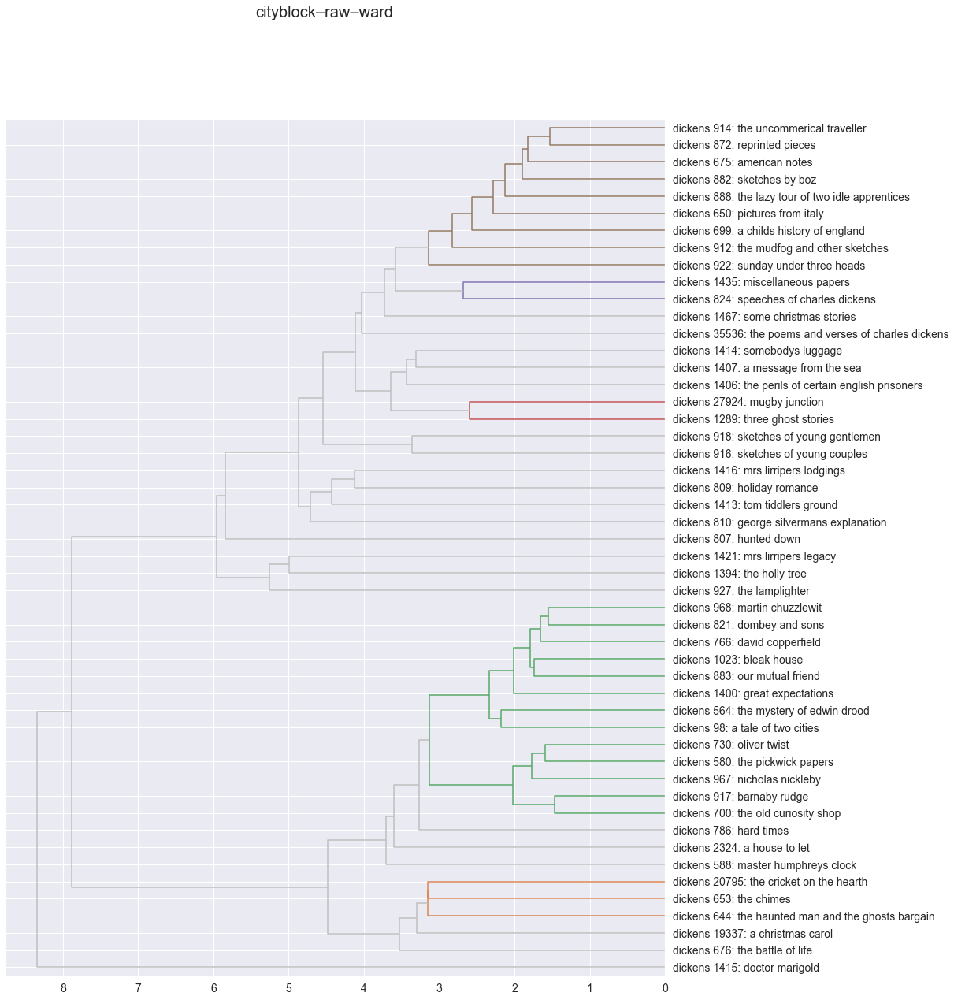

<Figure size 432x288 with 0 Axes>

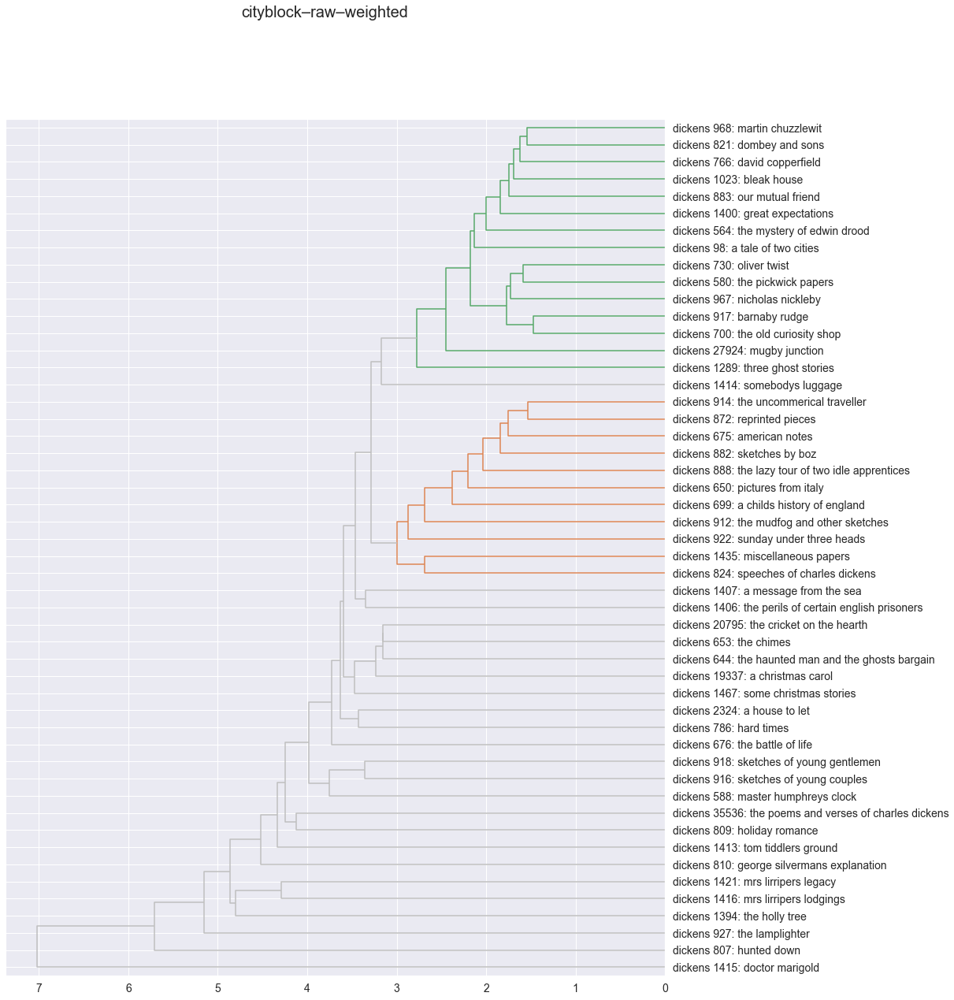

<Figure size 432x288 with 0 Axes>

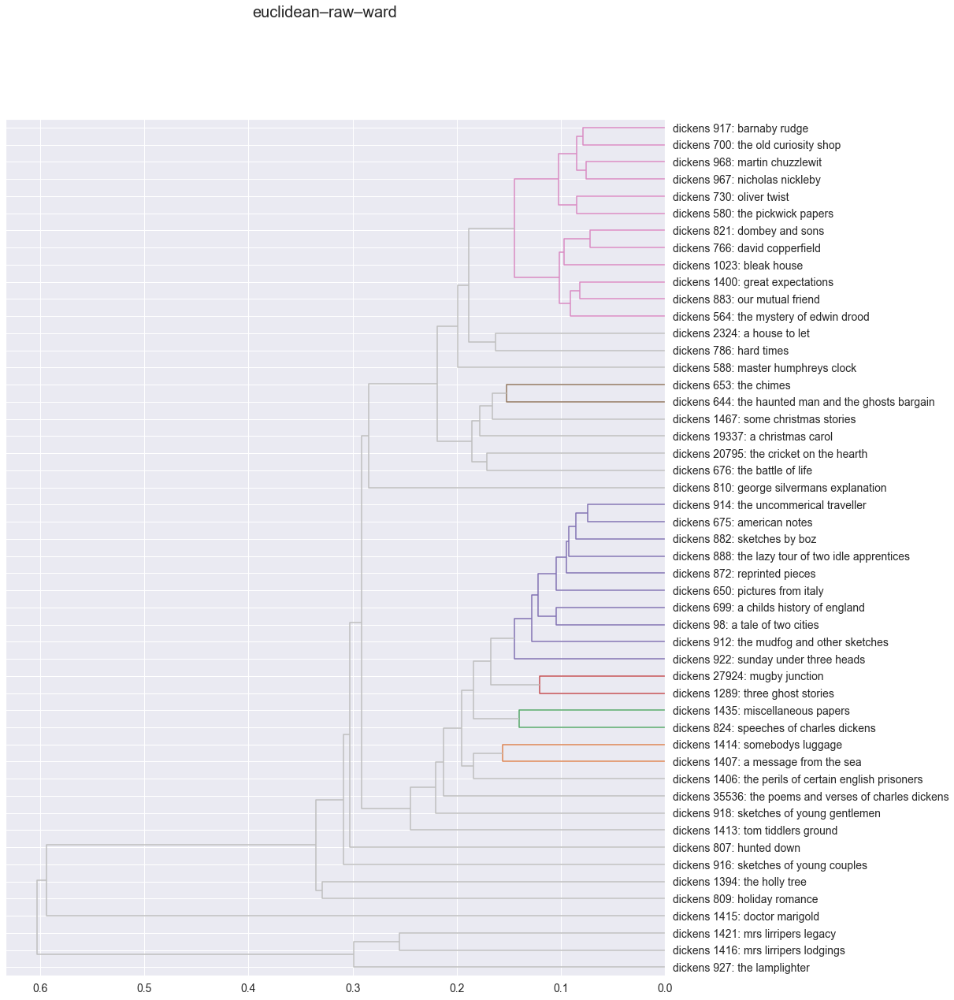

<Figure size 432x288 with 0 Axes>

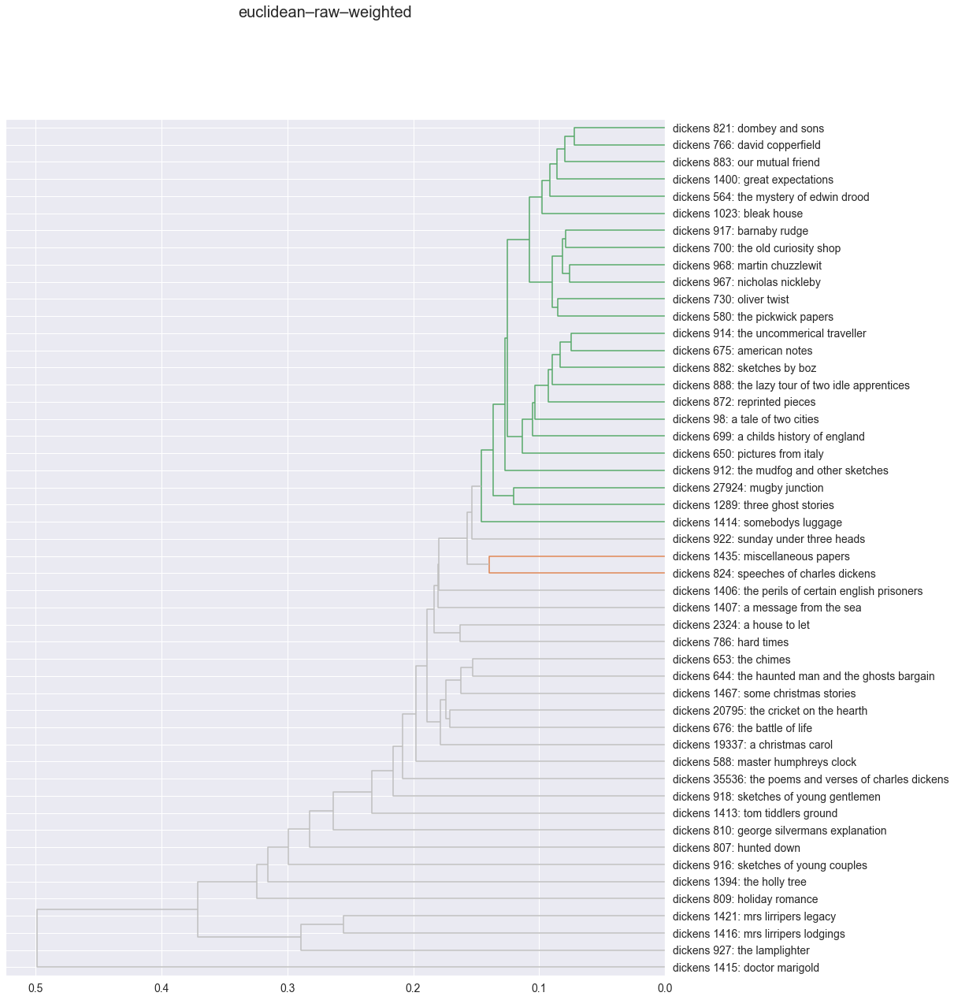

<Figure size 432x288 with 0 Axes>

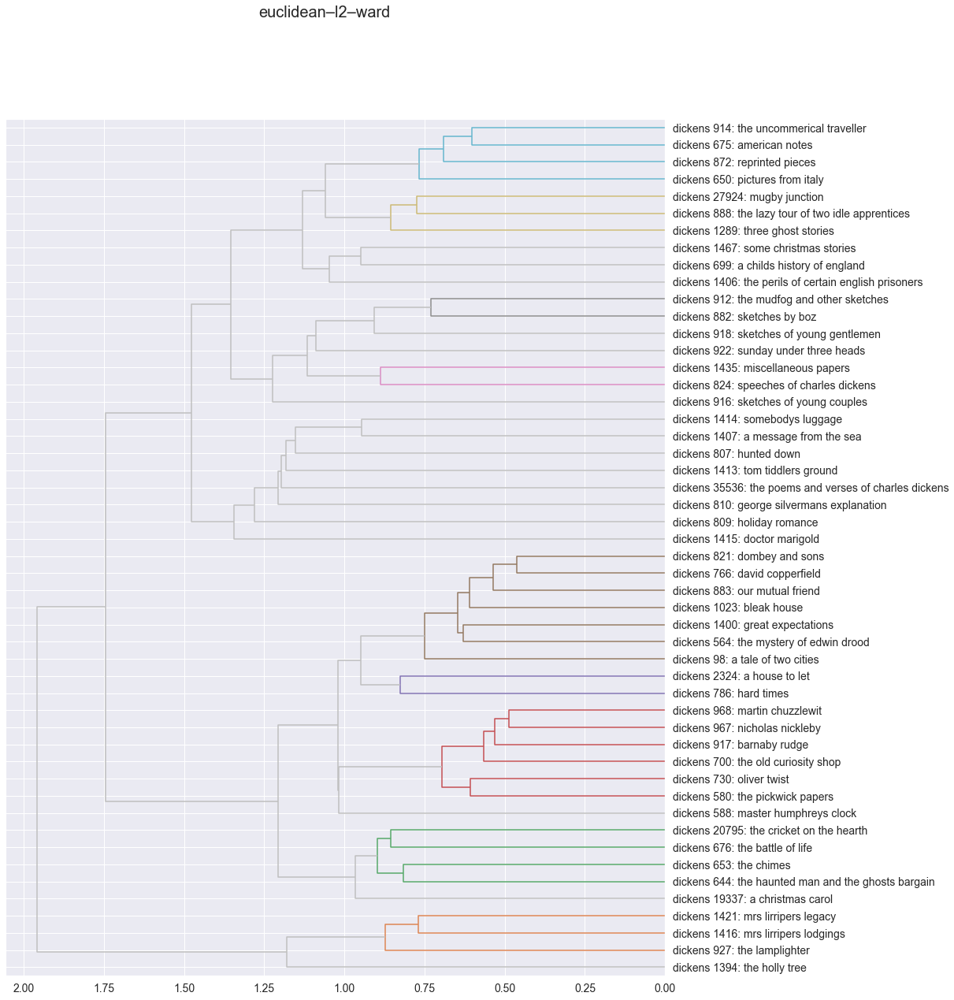

<Figure size 432x288 with 0 Axes>

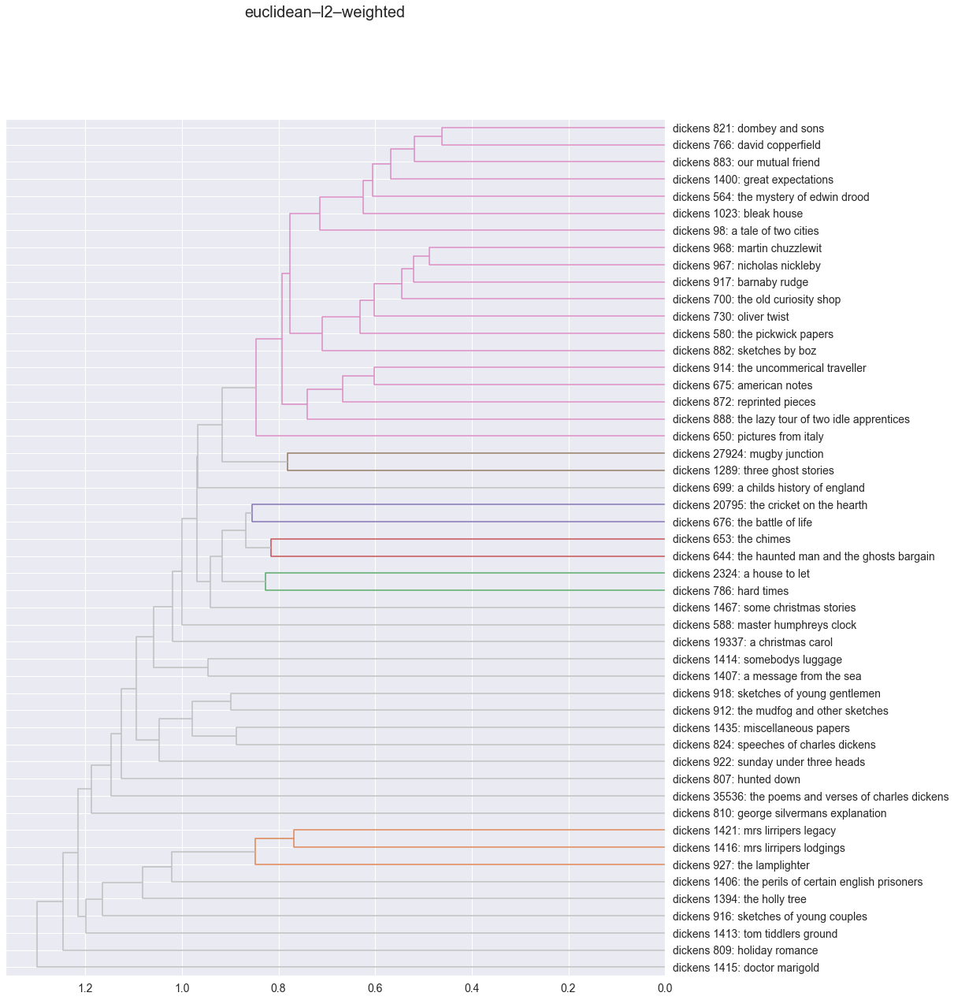

<Figure size 432x288 with 0 Axes>

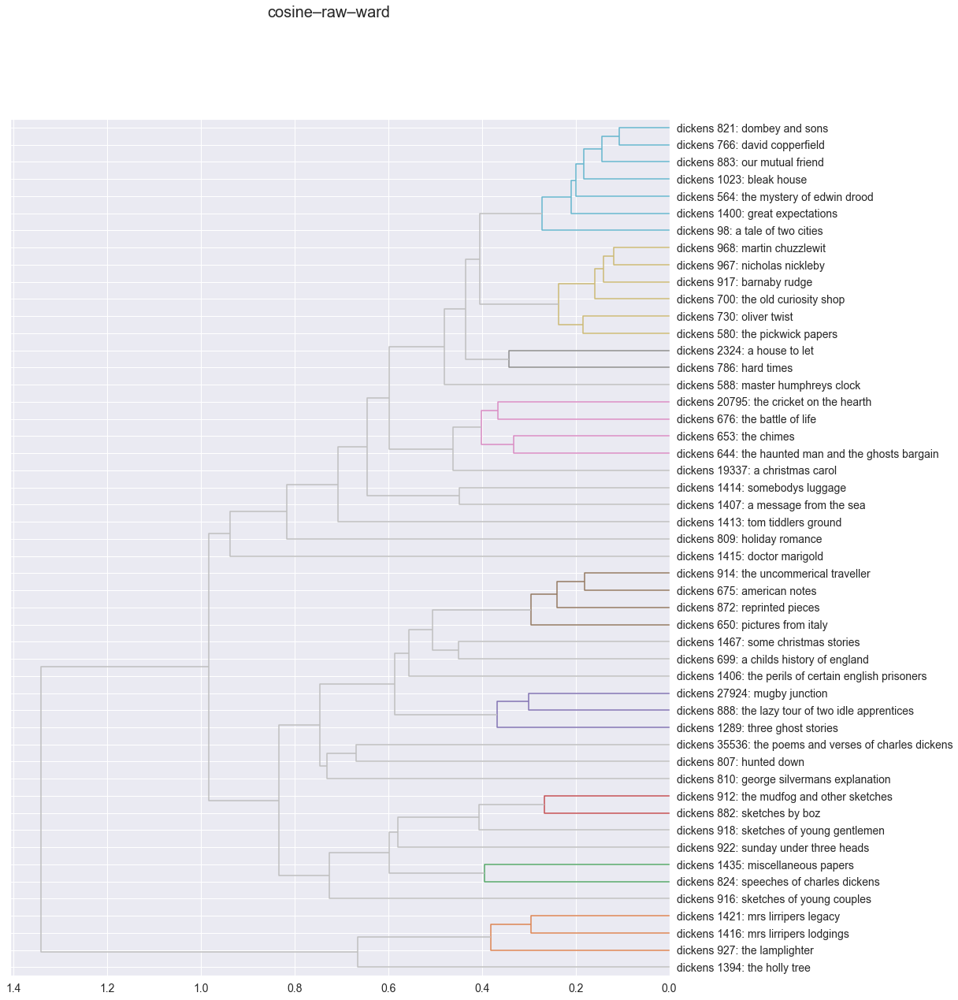

<Figure size 432x288 with 0 Axes>

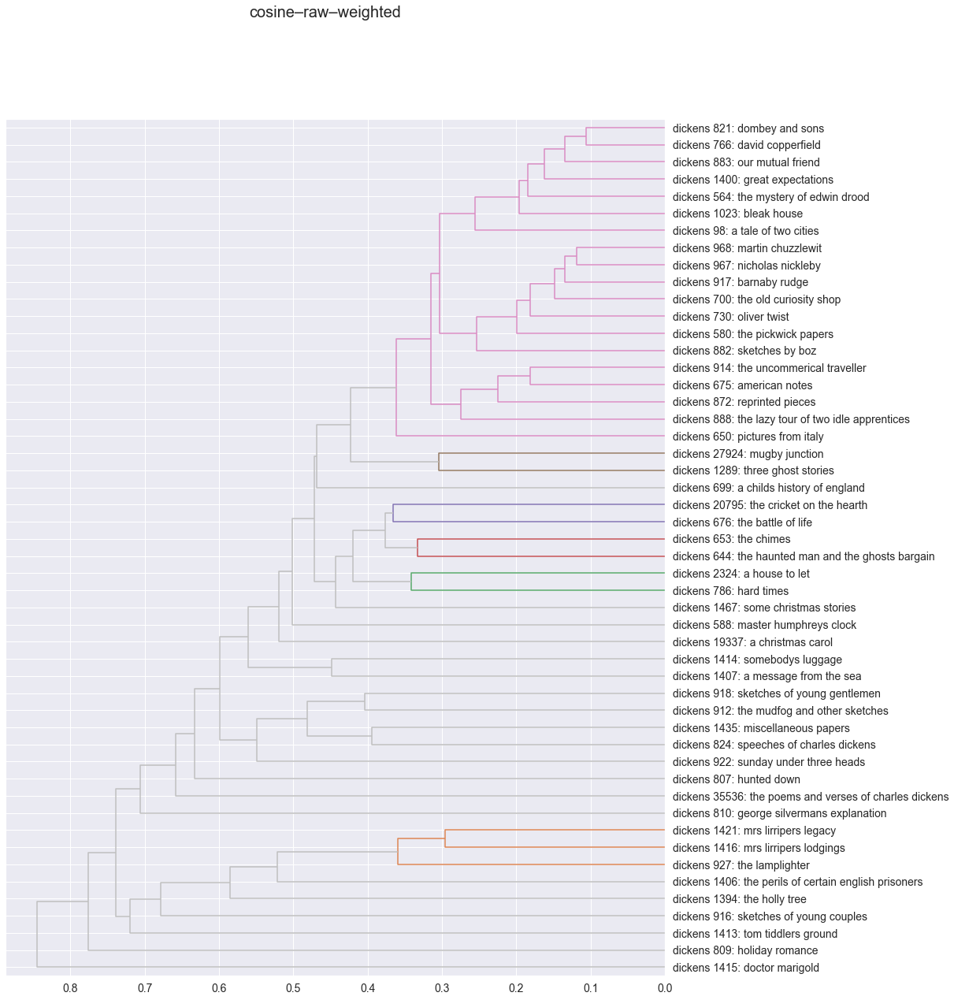

<Figure size 432x288 with 0 Axes>

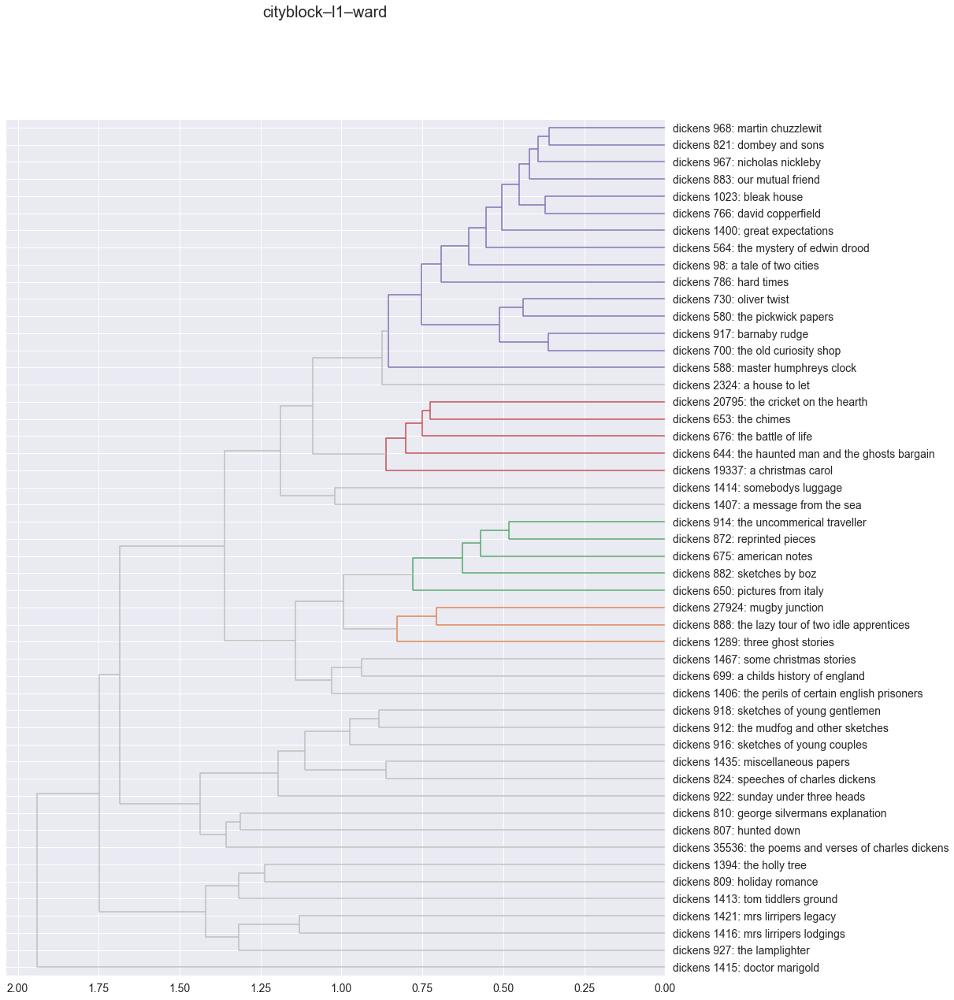

<Figure size 432x288 with 0 Axes>

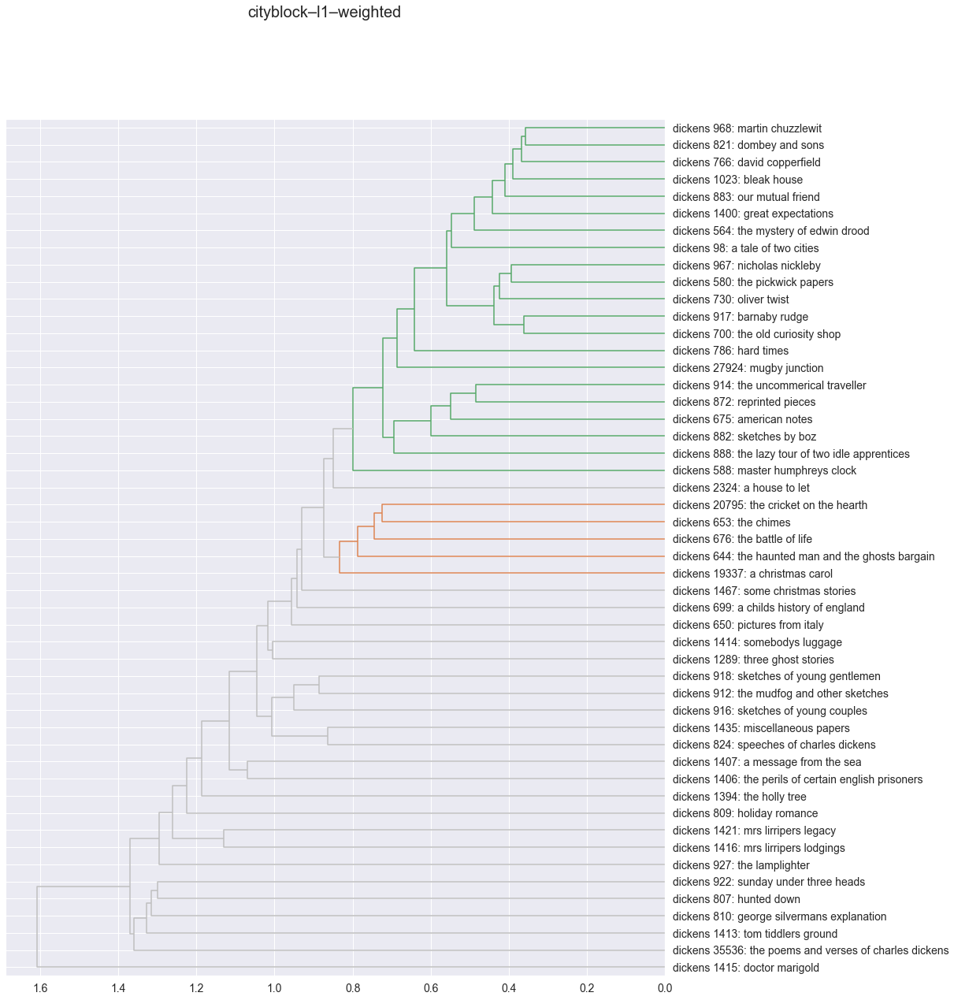

<Figure size 432x288 with 0 Axes>

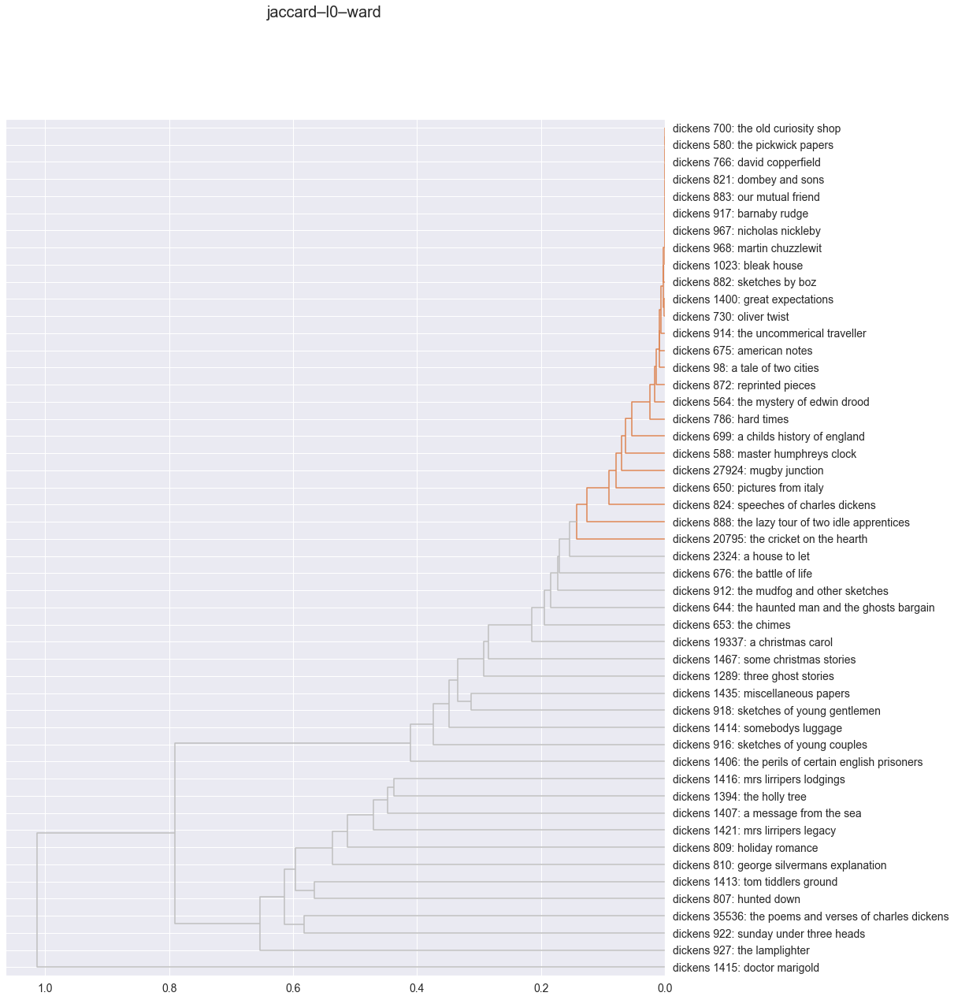

<Figure size 432x288 with 0 Axes>

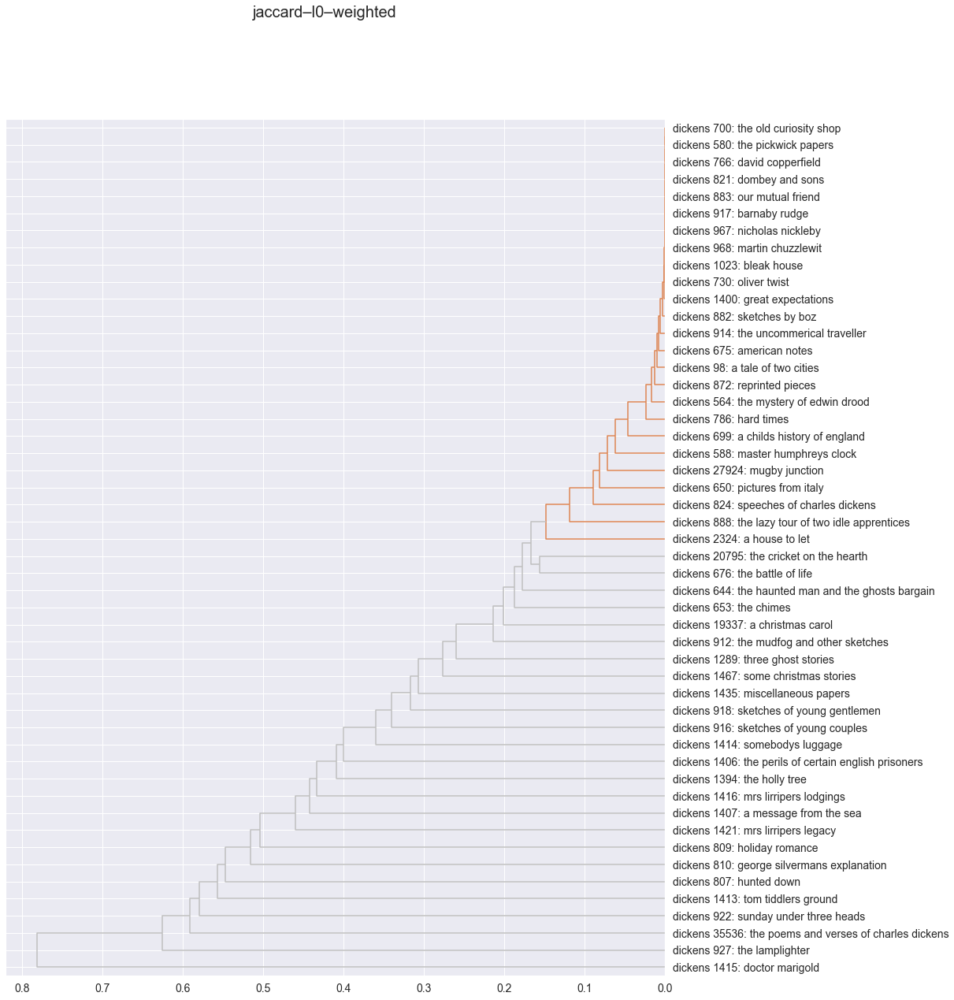

<Figure size 432x288 with 0 Axes>

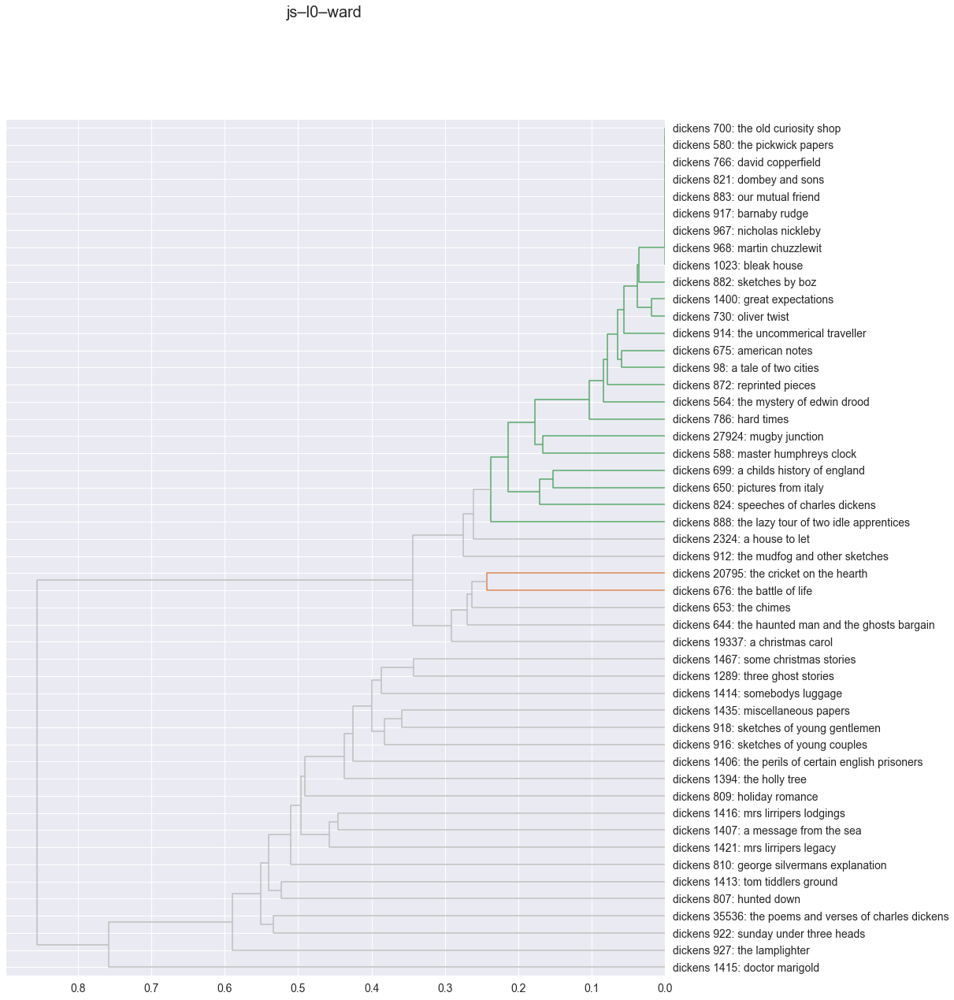

<Figure size 432x288 with 0 Axes>

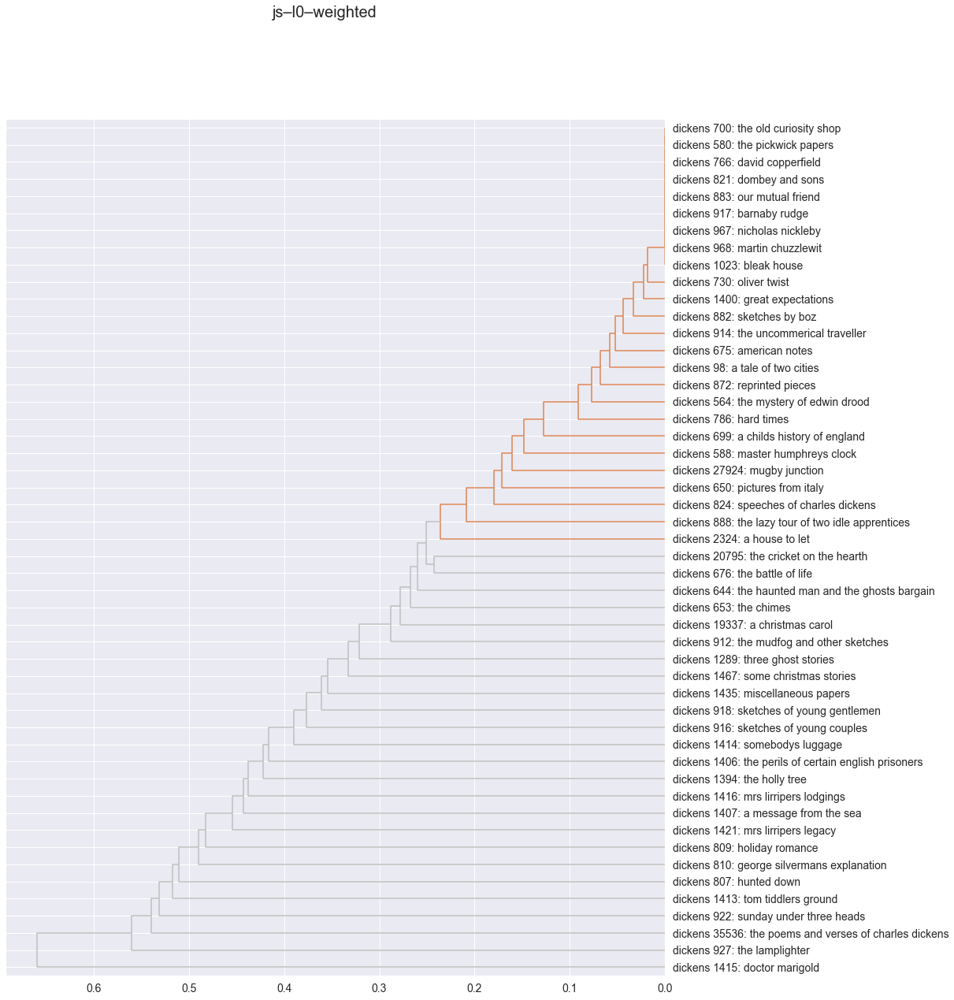

<Figure size 432x288 with 0 Axes>

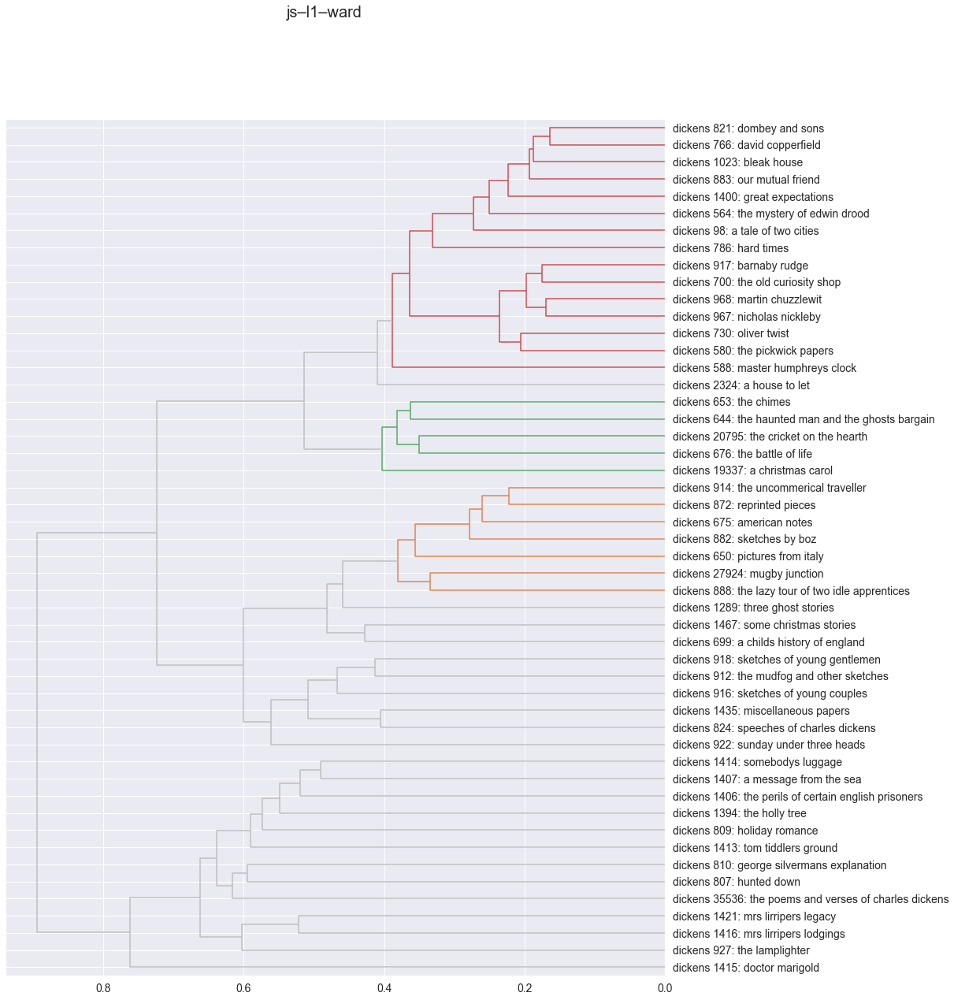

<Figure size 432x288 with 0 Axes>

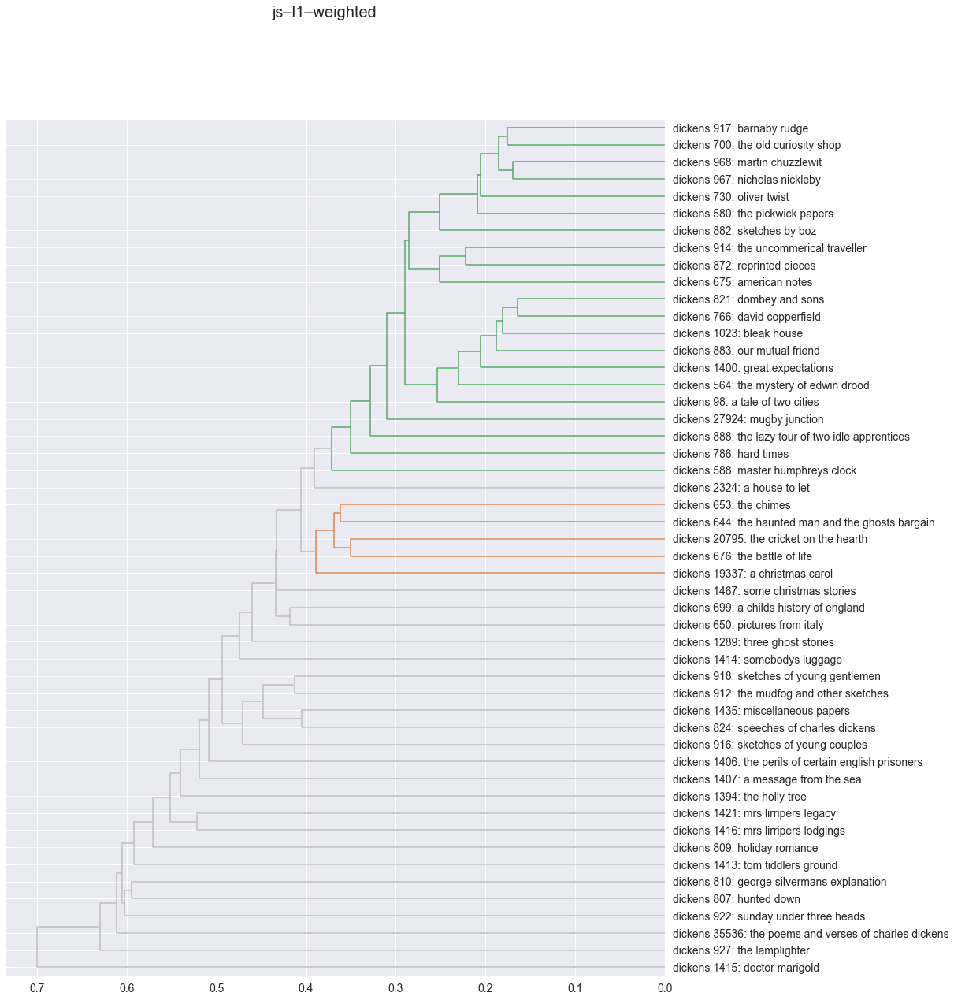

<Figure size 432x288 with 0 Axes>

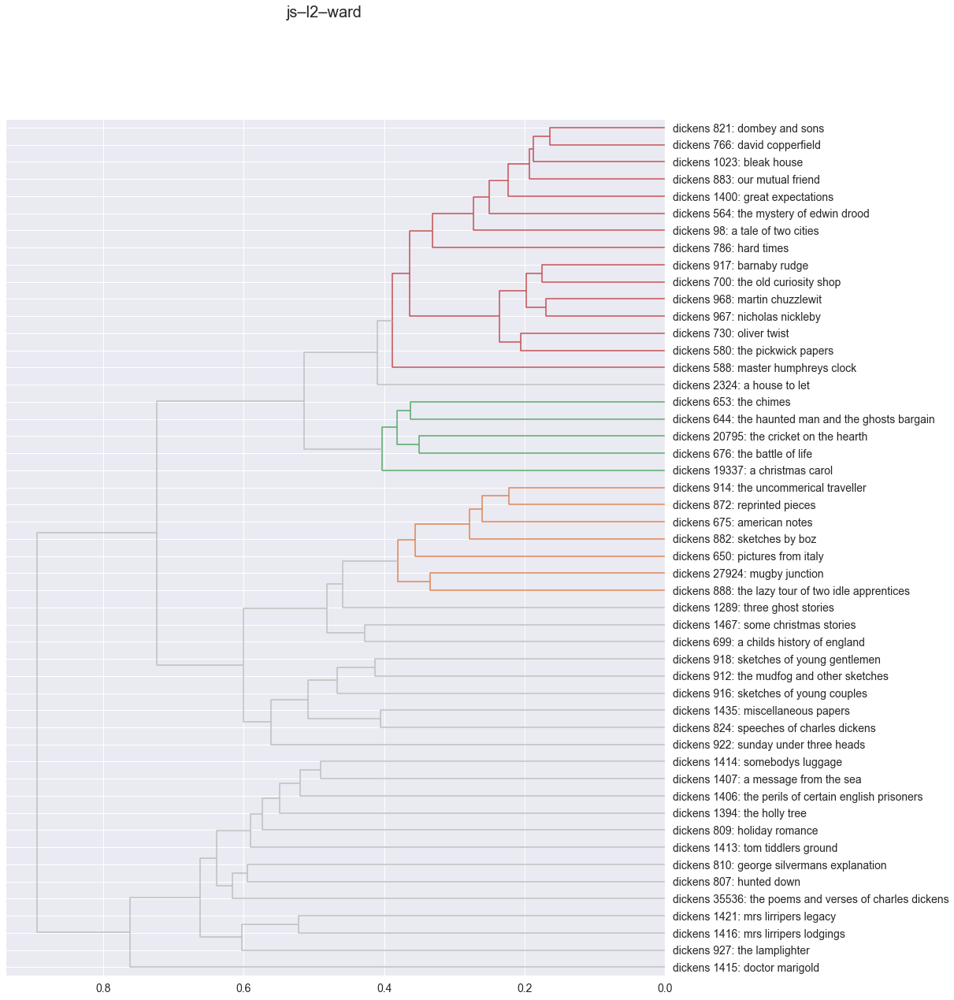

<Figure size 432x288 with 0 Axes>

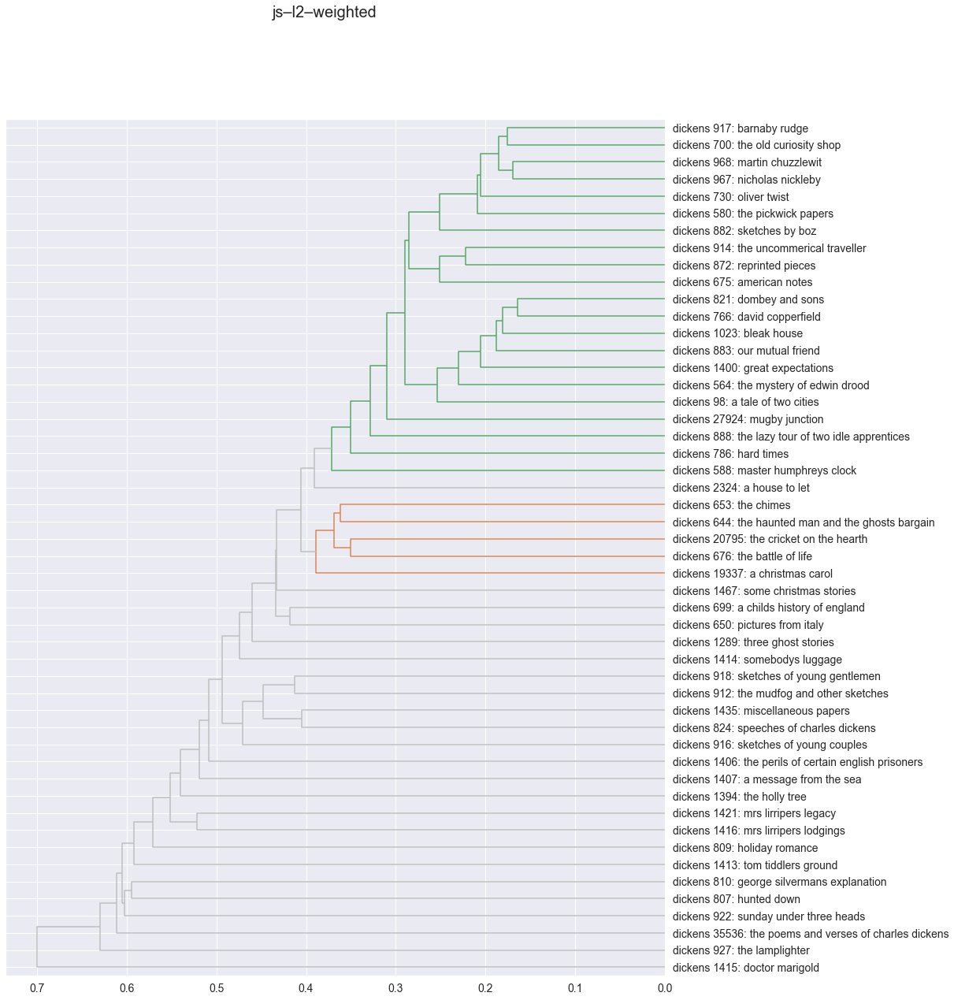

In [156]:
for combo in combos:
    # column in df (i.e., distance metric)
    m = combo[-1]
    
    # two lnikage methods
    for l in ['ward','weighted']:
        # title: distance metric - linkage method
        title = f"{m}–{l}"
        hca(PAIRS[m], title, linkage_method=l)

### **Top 20 nouns by DFIDF, sorted in descending order (including plural nouns but not proper nouns)**

In [70]:
# noun taglist (excluding proper nouns)
noun_tags = ['NN', 'NNS']

SIGS.loc[SIGS.max_pos.isin(noun_tags)].sort_values('dfidf', ascending = False).head(20)

,term_rank,n,n_chars,p,i,max_pos,n_pos,cat_pos,stop,stem_porter,stem_snowball,stem_lancaster,term_rank2,zipf_k,zipf_k2,tfidf_mean_chap_max,tfidf_max_chap_max,df,idf,dfidf
term_str,,,,,,,,,,,,,,,,,,,,
sleep,594,797,5,0.000160,12.606370,NN,9,"{'NNP', 'VBD', 'VBG', 'VBP', 'IN', 'VB', 'NN',...",0,sleep,sleep,sleep,538,473418,428786,0.012122,0.071449,434.0,1.445463,627.330980
windows,642,747,7,0.000150,12.699841,NNS,12,"{'WDT', 'VBD', 'PDT', 'VBP', 'IN', 'RB', 'VBZ'...",0,window,window,window,571,479574,426537,0.010575,0.076252,433.0,1.448791,627.326549
top,638,752,3,0.000151,12.690217,NN,8,"{'NNP', 'VBD', 'VBP', 'IN', 'VB', 'VBZ', 'NN',...",0,top,top,top,569,479776,427888,0.010093,0.056446,433.0,1.448791,627.326549
dress,659,730,5,0.000147,12.733053,NN,8,"{'VBP', 'IN', 'RB', 'VB', 'VBZ', 'NN', 'NNS', ...",0,dress,dress,dress,580,481070,423400,0.011136,0.056295,437.0,1.435525,627.324360
thank,565,849,5,0.000171,12.515185,NN,7,"{'NNP', 'VBD', 'VBP', 'IN', 'VB', 'NN', 'JJ'}",0,thank,thank,thank,515,479685,437235,0.014102,0.094442,437.0,1.435525,627.324360
confidence,633,757,10,0.000152,12.680656,NN,5,"{'NNP', 'VB', 'NNS', 'NN', 'JJ'}",0,confid,confid,confid,565,479181,427705,0.012530,0.079385,439.0,1.428937,627.303427
breast,660,729,6,0.000147,12.735030,NN,9,"{'VBD', 'VBN', 'VBP', 'IN', 'RB', 'VBZ', 'VB',...",0,breast,breast,breast,581,481140,423549,0.011534,0.054263,439.0,1.428937,627.303427
notice,728,644,6,0.000130,12.913889,NN,9,"{'NNP', 'VBN', 'VBP', 'IN', 'RB', 'VB', 'NNS',...",0,notic,notic,not,631,468832,406364,0.009954,0.058353,430.0,1.458821,627.293232
duty,667,721,4,0.000145,12.750950,NN,9,"{'NNP', 'VBN', 'VBP', 'IN', 'VB', 'NNS', 'NN',...",0,duti,duti,duty,587,480907,423227,0.012026,0.054560,427.0,1.468922,627.229720


In [71]:
top_20_nouns = list(VOCAB.loc[VOCAB.max_pos.isin(noun_tags)].sort_values('dfidf', ascending = False).head(20).index)

In [72]:
print(top_20_nouns)

['sleep', 'windows', 'top', 'thank', 'dress', 'confidence', 'breast', 'notice', 'duty', 'bless', 'number', 'stairs', 'breath', 'order', 'ladies', 'office', 'paper', 'knowledge', 'instant', 'mouth']


### **Most "Significant" Book based on mean TFIDF**

In [73]:
BOW.groupby(BOOKS).mean().sort_values('tfidf', ascending = False).join(LIB, on = 'book_id')

,n,tf,tfidf,source_file_path,title,chap_regex,author,type,year,decade,n_chaps,book_len,label
book_id,,,,,,,,,,,,,
35536,2.144928,0.037376,0.069868,Dickens/35536-the_poems_and_verses_of_charles_...,the poems and verses of charles dickens,THE VILLAGE COQUETTES$|THE LAMPLIGHTER$|SONGS ...,dickens,stories,1885,1880,13,10952,dickens 35536: the poems and verses of charles...
1415,2.952430,0.044903,0.053137,Dickens/1415-doctor_marigold.txt,doctor marigold,\* \* \* \* \*,dickens,stories,1865,1860,2,2855,dickens 1415: doctor marigold
810,2.757976,0.044831,0.048352,Dickens/810-george_silvermans_explanation.txt,george silvermans explanation,[A-Z]+\sCHAPTER$,dickens,stories,1868,1860,9,11065,dickens 810: george silvermans explanation
918,2.391451,0.033139,0.042115,Dickens/918-sketches_of_young_gentlemen.txt,sketches of young gentlemen,THE BASHFUL YOUNG GENTLEMAN$|THE OUT-AND-OUT Y...,dickens,stories,1838,1830,13,17063,dickens 918: sketches of young gentlemen
916,2.559015,0.031080,0.041771,Dickens/916-sketches_of_young_couples.txt,sketches of young couples,"AN URGENT REMONSTRANCE, &C.$|THE YOUNG COUPLE$...",dickens,stories,1840,1840,12,18082,dickens 916: sketches of young couples
824,2.618026,0.029218,0.039669,Dickens/824-speeches_of_charles_dickens.txt,speeches of charles dickens,[IVXLCM]+\.$,dickens,non-fiction,1870,1870,58,87984,dickens 824: speeches of charles dickens
807,2.997925,0.039372,0.039216,Dickens/807-hunted_down.txt,hunted down,^[IVXLCM]+\.$,dickens,stories,1859,1850,5,8670,dickens 807: hunted down
1435,3.055027,0.018592,0.026247,Dickens/1435-miscellaneous_papers.txt,miscellaneous papers,THE AGRICULTURAL INTEREST$|THREATENING LETTER ...,dickens,non-fiction,1840,1840,9,23762,dickens 1435: miscellaneous papers
786,4.259530,0.021844,0.026233,Dickens/786-hard_times.txt,hard times,CHAPTER\s[IVXLCM]+,dickens,novel,1854,1850,16,75760,dickens 786: hard times


### **Compare Distributions**

In [74]:
# merge PAIRS, LIB to add label col twice (for doc_a, doc_b) to include author, book_id, title

DISTS = pd.merge(PAIRS.reset_index(), LIB['label'], left_on = 'doc_a', right_on = 'book_id', how = 'left')
                                                                                                                                                                                                                                                      
DISTS = pd.merge(DISTS, LIB['label'], left_on = 'doc_b', right_on = 'book_id', how = 'right')

DISTS = DISTS.set_index(['doc_a', 'doc_b']).rename({'label_x': 'label_a', 'label_y': 'label_b'}, axis = 1)

In [75]:
# reorder df columns so that label_a and label_b first

DISTS.insert(loc = 0, column = 'label_a', value = DISTS.pop('label_a'))

DISTS.insert(loc = 1, column = 'label_b', value = DISTS.pop('label_b'))

In [76]:
DISTS.head(20).style.background_gradient(cmap='YlGnBu', high=.5, axis=0)

,,label_a,label_b,corr_raw,cityblock–raw,euclidean–raw,euclidean–l2,cosine–raw,cityblock–l1,jaccard–l0,js–l0,js–l1,js–l2
doc_a,doc_b,,,,,,,,,,,,
564.0,98.0,dickens 564: the mystery of edwin drood,dickens 98: a tale of two cities,0.817650,2.181992,0.102131,0.705128,0.248603,0.560497,0.017000,0.077078,0.261065,0.261065
580.0,98.0,dickens 580: the pickwick papers,dickens 98: a tale of two cities,1.002878,2.289080,0.110589,0.812632,0.330185,0.651664,0.006000,0.045650,0.296771,0.296771
588.0,98.0,dickens 588: master humphreys clock,dickens 98: a tale of two cities,0.946882,2.587732,0.125556,0.770693,0.296984,0.689925,0.123246,0.211748,0.330926,0.330926
644.0,98.0,dickens 644: the haunted man and the ghosts bargain,dickens 98: a tale of two cities,0.678359,2.233104,0.105889,0.811974,0.329651,0.668478,0.010010,0.059048,0.303062,0.303062
650.0,98.0,dickens 650: pictures from italy,dickens 98: a tale of two cities,0.871224,2.152545,0.108974,0.795297,0.316249,0.607677,0.007000,0.049329,0.282599,0.282599
653.0,98.0,dickens 653: the chimes,dickens 98: a tale of two cities,0.723809,3.706198,0.211257,1.039313,0.540086,1.052495,0.409045,0.410432,0.487383,0.487383
675.0,98.0,dickens 675: american notes,dickens 98: a tale of two cities,0.955682,2.137805,0.098926,0.789208,0.311424,0.679537,0.089089,0.178885,0.318723,0.318723
676.0,98.0,dickens 676: the battle of life,dickens 98: a tale of two cities,0.820688,4.551075,0.340992,1.198773,0.718528,1.208867,0.536072,0.486412,0.557537,0.557537
699.0,98.0,dickens 699: a childs history of england,dickens 98: a tale of two cities,0.769068,3.010372,0.147643,0.945397,0.446888,0.905983,0.348000,0.373570,0.443916,0.443916


### **Compare Z normalized distributions**

In [77]:
ZPAIRS = (PAIRS - PAIRS.mean()) / PAIRS.std()

In [78]:
ZPAIRS

corr_raw  cityblock–raw  euclidean–raw  euclidean–l2  cosine–raw  \
doc_a doc_b                                                                     
564   98    -0.793377      -1.379250      -1.117107     -1.680734   -1.584085   
580   98     0.814111      -1.272129      -1.018769     -1.038081   -1.070754   
      564   -0.277098      -0.470971      -0.397164     -0.475308   -0.561506   
588   98     0.328151      -0.973385      -0.844751     -1.288790   -1.279663   
      564   -1.057759      -0.971761      -0.961709     -0.645112   -0.721034   
...               ...            ...            ...           ...         ...   
35536 1467  -0.657405      -0.504204      -0.349307     -0.039757   -0.129099   
      2324   0.130957       0.506804       0.090930      0.862431    0.872827   
      19337  0.288699      -0.386278      -0.352837     -0.288472   -0.380110   
      20795  0.714052       0.752296       0.177578      0.899015    0.916479   
      27924  0.497169       0.272635      -0.168241      0.616982    0.586053   

             cityblock–l1  jaccard–l0     js–l0     js–l1     js–l2  
doc_a doc_b                                                          
564   98        -1.578464   -1.319745 -1.474008 -1.626327 -1.626327  
580   98        -1.220194   -1.375355 -1.674885 -1.304902 -1.304902  
      564       -0.769479   -1.167842 -1.142406 -0.877457 -0.877457  
588   98        -1.069836   -0.782614 -0.613239 -0.997442 -0.997442  
      564       -0.523605   -1.131869 -1.081498 -0.664586 -0.664586  
...                   ...         ...       ...       ...       ...  
35536 1467      -0.546136   -0.569091 -0.375189 -0.441440 -0.441440  
      2324       1.082217    0.934007  0.907707  0.998858  0.998858  
      19337     -0.681064   -0.782686 -0.604878 -0.664081 -0.664081  
      20795      1.025788    0.973376  0.927963  0.984284  0.984284  
      27924      0.840609    0.850490  0.810887  0.781297  0.781297  

[1225 rows x 10 columns]

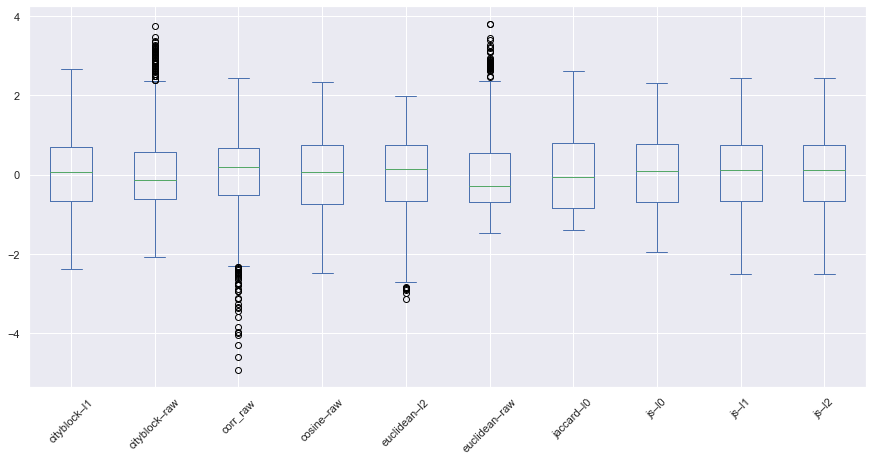

In [79]:
ZPAIRS.T.sort_index().T.plot.box(rot = 45, figsize = (15,7));

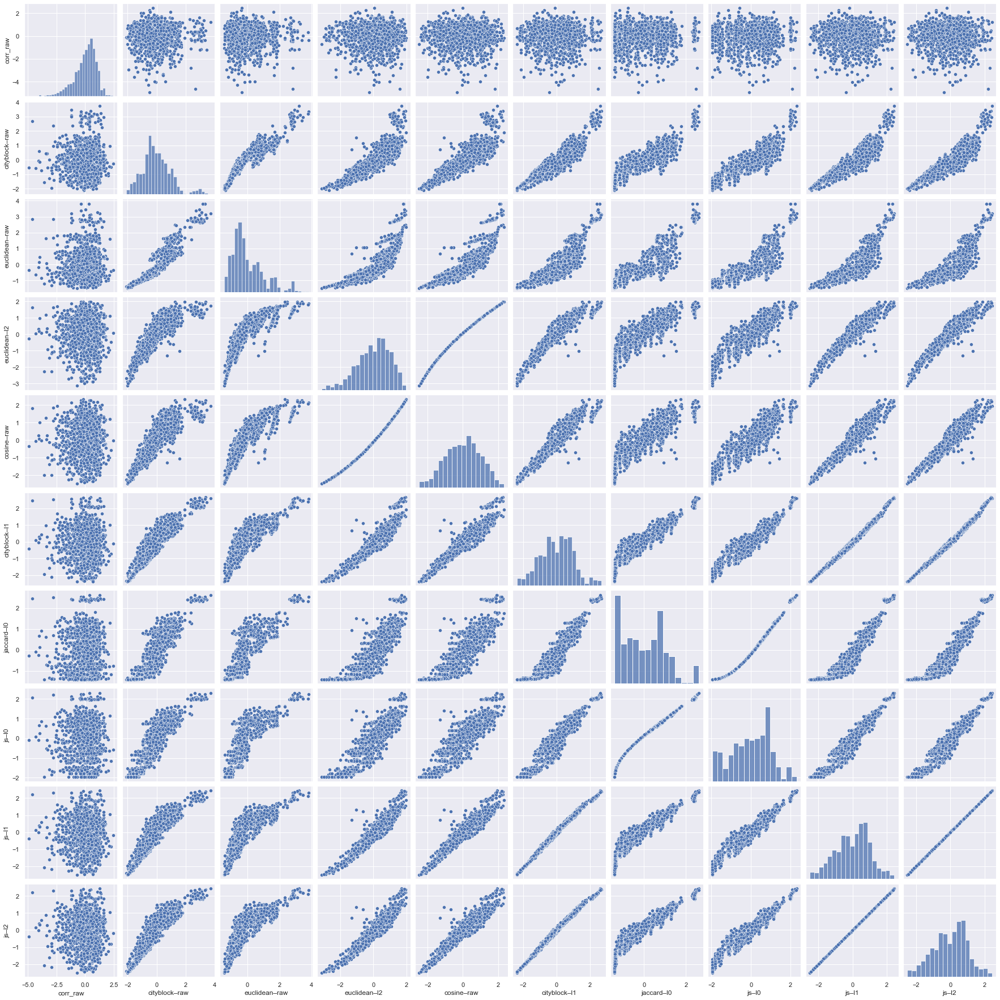

In [80]:
sns.pairplot(ZPAIRS);

### **K-Means**

**[Alogirthm Overview](https://en.wikipedia.org/wiki/K-means_clustering)**
* Goal: partition n observations of d-dimenstional real vectors so as to minimize the within-cluster sum of squares (WCSS), or variance
* Steps
    * Given an initial set of k means
    * Assignment setep: assign each observation to cluster with the nearest mean (centroid: multivariate mean in Euclidean space) based on Euclidean distance
        * Euclidean distance: $\sqrt{\sum_{i=1}^{n}(x_i - y_i)^2}$
        * Important to scale features to prevent those on larger scales from dominating
    * Update step: recalculate the means (centroids) for observations assigned to each cluster
    * Converged when assignemnts no longer change

In [81]:
n_clusters = 4

In [82]:
# instantiate KMeans model
km = KMeans(n_clusters, random_state = 314)

# compute cluster centers and predict cluster index for each sample using raw and normalized feature vectors
book_DOC['y_raw'] = km.fit_predict(mean_TFIDF_sigs)
book_DOC['y_L0'] = km.fit_predict(L0)
book_DOC['y_L1'] = km.fit_predict(L1)
book_DOC['y_L2'] = km.fit_predict(L2)

In [83]:
book_DOC.iloc[:,1:].sort_values('label').style.background_gradient(cmap = 'RdBu')

,title,label,y_raw,y_L0,y_L1,y_L2
book_id,,,,,,
1023,bleak house,dickens 1023: bleak house,3,0,0,3
1289,three ghost stories,dickens 1289: three ghost stories,3,0,0,0
1394,the holly tree,dickens 1394: the holly tree,3,2,0,3
1400,great expectations,dickens 1400: great expectations,3,0,0,3
1406,the perils of certain english prisoners,dickens 1406: the perils of certain english prisoners,3,2,0,3
1407,a message from the sea,dickens 1407: a message from the sea,3,2,0,0
1413,tom tiddlers ground,dickens 1413: tom tiddlers ground,3,2,0,3
1414,somebodys luggage,dickens 1414: somebodys luggage,3,2,0,0
1415,doctor marigold,dickens 1415: doctor marigold,0,3,2,1


In [84]:
# k values to test
k_vals = list(range(2, 11))

# different feature vectors to use
feature_vectors = {'raw': mean_TFIDF_sigs,
                   'L0': L0,
                   'L1': L1,
                   'L2': L2}

# empty dataframe
km_results = pd.DataFrame(columns = ['k', 'raw_silhouette_score', 'L0_silhouette_score', 'L1_silhouette_score', 'L2_silhouette_score'])

# loop through k values (num of clusters) and compute silhouette score to find best of combo of k, feature vector
for k in k_vals:
    km = KMeans(k, random_state = 314)
    
    results = [k]
    
    for vec in feature_vectors.values():
        labels = km.fit_predict(vec)
        
        results.append(silhouette_score(vec, labels))
    
    km_results.loc[len(km_results)] = results

In [85]:
km_results.style.background_gradient(cmap = 'RdBu', axis = None, subset = km_results.columns[1:])

,k,raw_silhouette_score,L0_silhouette_score,L1_silhouette_score,L2_silhouette_score
0,2.000000,0.434304,0.375481,0.416088,0.153934
1,3.000000,0.447782,0.350379,0.424456,0.062581
2,4.000000,0.316780,0.355775,0.405744,0.063818
3,5.000000,0.313854,0.356422,0.046932,0.076669
4,6.000000,0.045889,0.352762,0.247122,0.070491
5,7.000000,0.049817,0.355153,0.252137,0.068152
6,8.000000,0.005861,0.317736,0.066262,0.046934
7,9.000000,0.048023,0.342503,0.253976,0.052131
8,10.000000,0.065307,0.298556,0.082754,0.066405


In [86]:
# overall highest silhouette score
max_silhouette_score = km_results.iloc[:,1:].max().max()

# k value (num of clusters) corresponding to the highest silhouette score
max_score_cluster = km_results.loc[km_results[km_results == max_silhouette_score].any(axis = 1)]['k'].iloc[0]

# feature vector corresponding to the highest silhouette score
max_score_vec = km_results.loc[km_results[km_results == max_silhouette_score].any(axis = 1)].iloc[:, 1:].idxmax(axis = 1).iloc[0]

In [87]:
max_score_vec

'raw_silhouette_score'

In [88]:
# create a col with labels corresponding to k value, feature vector that yield highest silhouette score
km = KMeans(int(max_score_cluster), random_state = 314)

max_col_name = 'max_y_{}'.format(max_score_vec.split('_')[0])

book_DOC[max_col_name] = km.fit_predict(feature_vectors[max_score_vec.split('_')[0]])

In [89]:
# add to see cluster breakdown by type
book_DOC = book_DOC.join(LIB['type'])

In [90]:
book_DOC[['label', 'type', max_col_name]].sort_values(max_col_name).style.background_gradient(cmap = 'RdBu')

,label,type,max_y_raw
book_id,,,
927,dickens 927: the lamplighter,stories,0
1421,dickens 1421: mrs lirripers legacy,stories,0
1416,dickens 1416: mrs lirripers lodgings,stories,0
98,dickens 98: a tale of two cities,novel,1
917,dickens 917: barnaby rudge,stories,1
918,dickens 918: sketches of young gentlemen,stories,1
922,dickens 922: sunday under three heads,non-fiction,1
967,dickens 967: nicholas nickleby,novel,1
968,dickens 968: martin chuzzlewit,novel,1


In [91]:
book_DOC.groupby(max_col_name).size()

max_y_raw
0     3
1    46
2     1
dtype: int64

In [92]:
# cluster breakdown by type
book_DOC.groupby(['type', max_col_name]).size()

type         max_y_raw
non-fiction  1             7
novel        1            17
stories      0             3
             1            22
             2             1
dtype: int64

## **M07: Features and Components**

In [93]:
chap_DOC = pd.DataFrame(index = TFIDF.index)

chap_DOC = chap_DOC.join(LIB[['author', 'title', 'type', 'decade']], on = 'book_id')

chap_DOC['label'] = chap_DOC.apply(lambda x: "{}-{}--{}-{}".format(x.name[0], x.author, x.title, x.name[1]), 1)

chap_DOC['mean_tfidf'] = TFIDF.mean(1)

chap_DOC['n_tokens'] = BOW.groupby(OHCO[:2]).n.sum()

In [94]:
chap_DOC

author                                    title     type  \
book_id chap_id                                                              
98      1        dickens                     a tale of two cities    novel   
        2        dickens                     a tale of two cities    novel   
        3        dickens                     a tale of two cities    novel   
        4        dickens                     a tale of two cities    novel   
        5        dickens                     a tale of two cities    novel   
...                  ...                                      ...      ...   
35536   9        dickens  the poems and verses of charles dickens  stories   
        10       dickens  the poems and verses of charles dickens  stories   
        11       dickens  the poems and verses of charles dickens  stories   
        12       dickens  the poems and verses of charles dickens  stories   
        13       dickens  the poems and verses of charles dickens  stories   

                 decade                                              label  \
book_id chap_id                                                              
98      1          1850                 98-dickens--a tale of two cities-1   
        2          1850                 98-dickens--a tale of two cities-2   
        3          1850                 98-dickens--a tale of two cities-3   
        4          1850                 98-dickens--a tale of two cities-4   
        5          1850                 98-dickens--a tale of two cities-5   
...                 ...                                                ...   
35536   9          1880  35536-dickens--the poems and verses of charles...   
        10         1880  35536-dickens--the poems and verses of charles...   
        11         1880  35536-dickens--the poems and verses of charles...   
        12         1880  35536-dickens--the poems and verses of charles...   
        13         1880  35536-dickens--the poems and verses of charles...   

                 mean_tfidf  n_tokens  
book_id chap_id                        
98      1          0.000363      1017  
        2          0.000233      2044  
        3          0.000269      1638  
        4          0.000422      4439  
        5          0.000330      4218  
...                     ...       ...  
35536   9          0.000507       942  
        10         0.000797       356  
        11         0.000327       685  
        12         0.000338       547  
        13         0.000671       439  

[1182 rows x 7 columns]

### **Manual PCA Methods with Only 1000 Most Significant Terms (excluding proper nouns)**

In [95]:
LOADINGS, DCM, COMPINF = get_pca(TFIDF_sigs, norm_docs = True, center_by_mean = False, center_by_variance = False)

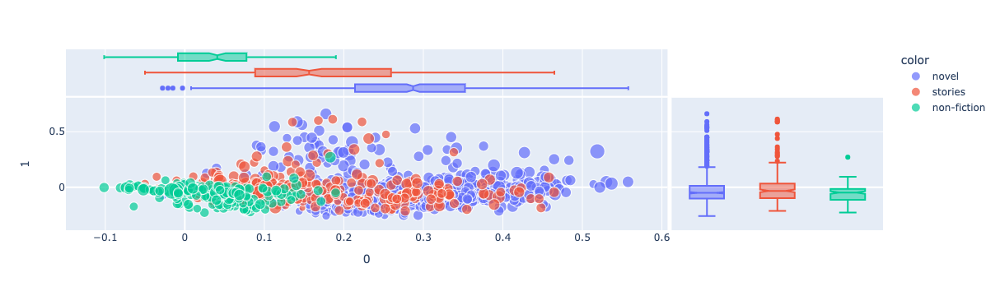

In [96]:
px.scatter(DCM, 0, 1, color=chap_DOC.type, 
           size=np.abs(chap_DOC.mean_tfidf), hover_name=chap_DOC.label, 
           marginal_x='box', marginal_y='box', height=1000)

In [97]:
X = LOADINGS.join(SIGS, how='inner').reset_index()

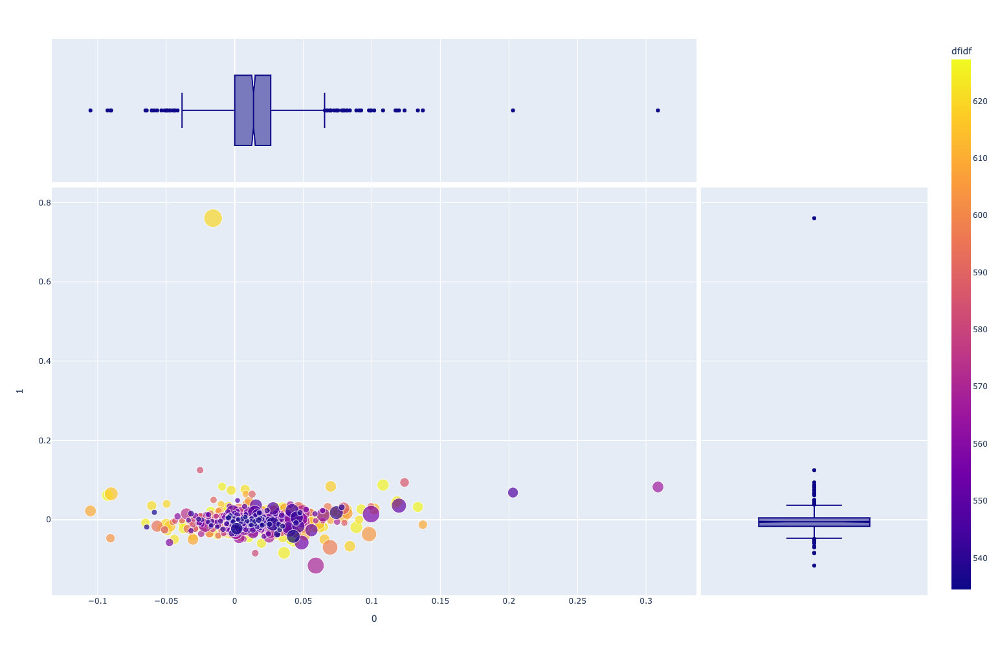

In [98]:
px.scatter(X, 0, 1, size=X.n, color=X.dfidf, 
           hover_name='term_str', hover_data=['max_pos'], 
           marginal_x='box', marginal_y='box', 
           height=1000, width=1000)

In [99]:
COMPINF

,pos,neg,eig_val,exp_var
pc_id,,,,
0,ha maam rejoined inquired aint,public ladies sea gentlemen houses,0.017467,0.156175
1,says takes aint em o,child loved brother father sister,0.016741,0.149683
2,maam sister ladies brother marriage,ha horses crowd road river,0.014116,0.126209
3,ha ladies gentlemen inquired coach,says child father mother loved,0.013638,0.121941
4,coach maam ladies shop town,ha eh brother o rejoined,0.010121,0.090495
5,maam mother child boys boy,ha gentlemen brother court office,0.009784,0.087477
6,brother son maam court father,child ladies love happy girl,0.008110,0.072511
7,sister boy aint o boys,ha maam gentlemen ladies says,0.007541,0.067423
8,ladies boys father boy son,maam letter office river reference,0.007492,0.066984


### **Prince PCA Method with entire TFIDF**

In [139]:
pca = PCA(
    n_components=6,
    n_iter=3,
    rescale_with_mean=False, # Already set and applied to TFIDF
    rescale_with_std=False, # Already set and applied to TFIDF
    copy=True,
    check_input=True,
    engine='auto',
    random_state=42
)

In [140]:
pca = pca.fit(TFIDF)

In [141]:
dcm = pca.transform(TFIDF)

In [142]:
dcm

0         1         2         3         4         5
book_id chap_id                                                            
98      1        0.079602 -0.047823 -0.032369  0.022100 -0.028963 -0.002443
        2        0.080926 -0.050889 -0.033654  0.017720 -0.035551  0.008480
        3        0.077527 -0.043145 -0.028152  0.018199 -0.025712  0.004466
        4        0.176733 -0.106757 -0.057149  0.045436 -0.043284  0.005294
        5        0.108728 -0.070882 -0.018355  0.023081 -0.020364  0.021739
...                   ...       ...       ...       ...       ...       ...
35536   9        0.125069 -0.072843 -0.055778  0.018766 -0.043503  0.008264
        10       0.503005  0.189780 -0.045538 -0.070940 -0.269298  0.248859
        11       0.082916 -0.048396 -0.036694  0.014311 -0.034964 -0.007043
        12       0.079417 -0.044509 -0.030858  0.015558 -0.033919  0.009589
        13       0.211297 -0.120470 -0.095485  0.067477 -0.114600  0.044557

[1182 rows x 6 columns]

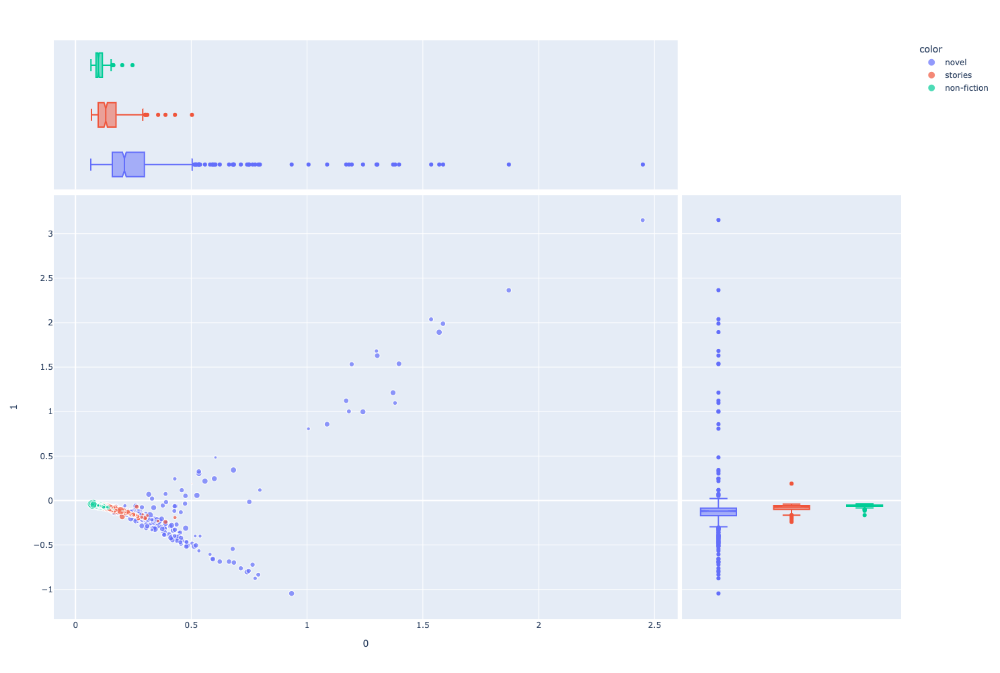

In [143]:
px.scatter(dcm, 0, 1, 
           color=chap_DOC.type,
           size=chap_DOC.n_tokens, hover_name=chap_DOC.label, 
           height=1000, width=1200, 
           marginal_x='box', marginal_y='box')

#### **Remove Outliers**

In [105]:
# function to calculate the upper fence / bound in the box plots above for the different PCs

def upper_fence(df, books, pc):
    pc_IQR = df.loc[books, pc].quantile(0.75) - df.loc[books, pc].quantile(0.25)
    return 1.5 * pc_IQR + df.loc[books, pc].quantile(0.75)

In [106]:
# upper fences for pc 0
dickens_0_upper_fence = upper_fence(dcm, LIB.index.values, 0)

# upper fences for pc 1
dickens_1_upper_fence = upper_fence(dcm, LIB.index.values, 1)

In [107]:
# outliers the chapters in books with PC 0 or PC 1 greater than the max of the upper fence for dickens and twain for each PC
outliers = dcm.loc[(dcm[0] > dickens_0_upper_fence) | (dcm[1] > dickens_1_upper_fence)].index.values

In [108]:
# remove outliers from corpus
small_CORPUS = CORPUS.loc[~CORPUS.index.droplevel(['para_num', 'sent_num', 'token_num']) \
                                  .isin(outliers)]

In [117]:
# remove outliers from vocab
small_VOCAB = VOCAB.loc[VOCAB.index.isin(small_CORPUS.term_str)]

# remove proper nounrs
proper_nouns = ['NNP', 'NNPS']

small_VOCAB = VOCAB.loc[~VOCAB.max_pos.isin(proper_nouns)]

# remove numbers
small_VOCAB = small_VOCAB.loc[~small_VOCAB.index.str.contains('[0-9]', regex = True)]

In [118]:
# remove ~15% of VOCAB data

(VOCAB.shape[0] - small_VOCAB.shape[0]) / VOCAB.shape[0]

0.15425531914893617

In [119]:
# remove proper nouns and numbers from corpus
small_CORPUS = small_CORPUS.loc[small_CORPUS.term_str.isin(small_VOCAB.index.values)]

In [120]:
# remove ~11% of data

(CORPUS.shape[0] - small_CORPUS.shape[0]) / CORPUS.shape[0]

0.10609553711053038

In [121]:
small_BOW = create_bow(small_CORPUS, CHAPS)

In [122]:
# suppress chained assignment warning
pd.options.mode.chained_assignment = None

In [123]:
small_DTCM, small_TFIDF, small_BOW, small_DFIDF, small_VOCAB = get_tfidf(small_BOW, small_VOCAB, tf_method = 'max', idf_method = 'standard')

In [124]:
small_chap_DOC = pd.DataFrame(index = small_TFIDF.index)

small_chap_DOC = small_chap_DOC.join(LIB[['author', 'title', 'type', 'decade']], on = 'book_id')

small_chap_DOC['label'] = small_chap_DOC.apply(lambda x: "{}-{}-{}".format(x.name[0], x.author, x.name[1]), 1)

small_chap_DOC['mean_tfidf'] = TFIDF.mean(1)

small_chap_DOC['n_tokens'] = small_BOW.groupby(OHCO[:2]).n.sum()

In [125]:
small_pca = pca.fit(small_TFIDF)

In [126]:
small_dcm = pca.transform(small_TFIDF)

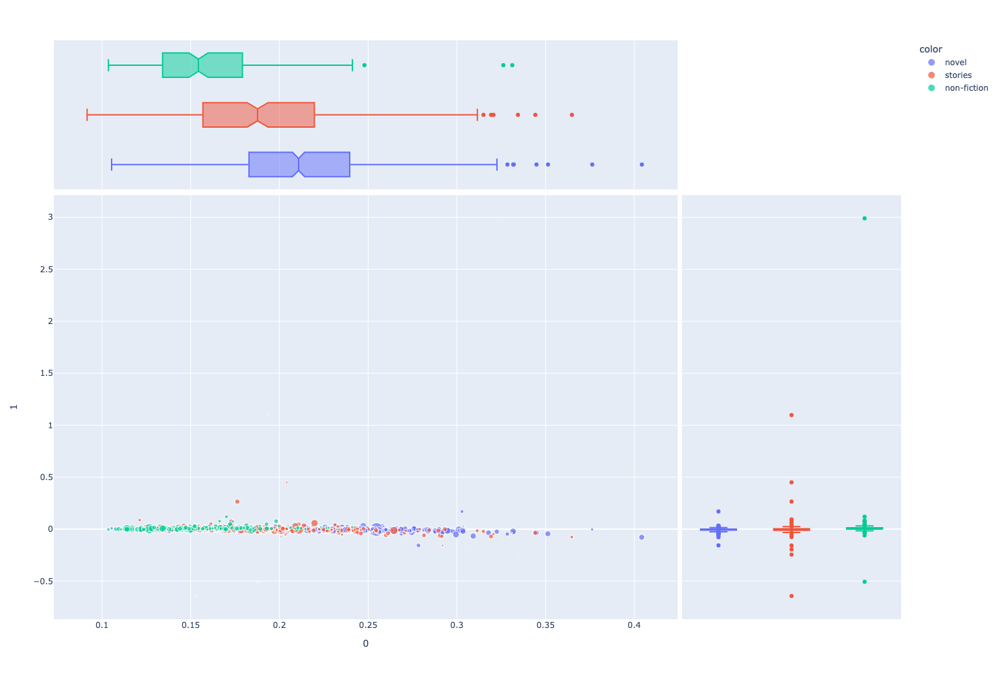

In [127]:
px.scatter(small_dcm, 0, 1, 
           color=small_chap_DOC.type,
           size=small_chap_DOC.n_tokens, hover_name=small_chap_DOC.label, 
           height=1000, width=1200, 
           marginal_x='box', marginal_y='box')

### **Prince PCA Method with 1000 most significant terms excluding proper nouns (`TFIDF_sigs`)**

In [128]:
pca_sigs = pca.fit(TFIDF_sigs)

In [129]:
dcm_sigs = pca_sigs.transform(TFIDF_sigs)

In [130]:
dcm_sigs

0         1         2         3         4         5
book_id chap_id                                                            
98      1        0.059308  0.027044 -0.004335  0.002380 -0.007692 -0.010751
        2        0.064570 -0.009571 -0.008245 -0.023042  0.019243  0.009329
        3        0.083818  0.014368 -0.013850 -0.018862 -0.002281  0.017569
        4        0.144831  0.012586 -0.011949 -0.017702 -0.018918  0.001366
        5        0.099830 -0.004260 -0.004859 -0.025189 -0.001643  0.008036
...                   ...       ...       ...       ...       ...       ...
35536   9        0.088392  0.011102 -0.007005 -0.002917 -0.019529 -0.001646
        10       0.184596 -0.012318  0.001723 -0.034009  0.035516 -0.121150
        11       0.072715  0.016359 -0.004793 -0.000527 -0.023610  0.017840
        12       0.072537  0.022408 -0.005806  0.002997 -0.015566 -0.019207
        13       0.107308  0.026861 -0.012891 -0.000272 -0.013886 -0.025155

[1182 rows x 6 columns]

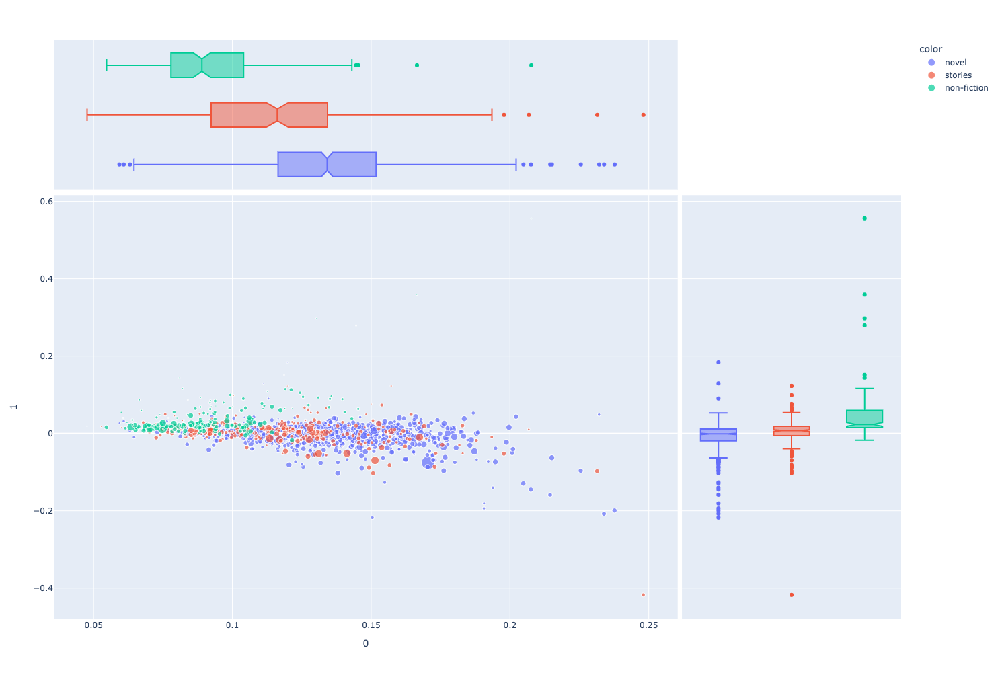

In [131]:
px.scatter(dcm_sigs, 0, 1, 
           color=chap_DOC.type,
           size=chap_DOC.n_tokens, hover_name=chap_DOC.label, 
           height=1000, width=1200, 
           marginal_x='box', marginal_y='box')

In [132]:
# save BOW for topic modeling

BOW.to_csv(f'dickens_BOW.csv')